In [1]:
"""

EATING DISORDERS MONTECATINI

Purpose: fit HDDMrl model M8 to the three-groups (HC, RI, AN) data.

Written by Corrado Caudek (2023-06-30)

"""

# Virtual environment: py37_env

import datetime

now = datetime.datetime.now()
print("Current date and time : ")
print(now.strftime("%Y-%m-%d %H:%M:%S"))


Current date and time : 
2023-07-06 11:02:28


This notebook follows the [tutorial](https://hddm.readthedocs.io/en/latest/demo_RLHDDMtutorial.html#checking-results) on the hddm webpage.


In [2]:
%matplotlib inline 

import os, time, csv, sys
import glob

import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.distributions.empirical_distribution import ECDF
from scipy import stats

import pymc
import pymc as pm
import hddm
import kabuki
import arviz as az

import pymc.progressbar as pbar
import pathlib

from kabuki.utils import concat_models
from kabuki.analyze import check_geweke
from kabuki.analyze import gelman_rubin

from patsy import dmatrix  # for generation of (regression) design matrices
import pickle

from tqdm import tqdm

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.filterwarnings("ignore", category=DeprecationWarning)
warnings.filterwarnings("ignore", category=np.VisibleDeprecationWarning)

# Data management
pd.options.display.max_colwidth = 100

print(f"The hddm version is {hddm.__version__}")

/Users/corrado/mambaforge/envs/py37_env/lib/python3.7/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


The hddm version is 0.9.8


In [3]:
RANDOM_SEED = 8927
rng = np.random.default_rng(RANDOM_SEED)

%config InlineBackend.figure_format = 'retina'
az.style.use("arviz-white")

In [5]:
# Set display options to show all rows and columns
pd.set_option("display.max_rows", None)
pd.set_option("display.max_columns", None)

# Reset display options to their default values
# pd.reset_option('display.max_rows')
# pd.reset_option('display.max_columns')

In [5]:
# custom save/load fns
def savePatch(self, fname):
    with open(fname, "wb") as f:  # write binary
        pickle.dump(self, f)


hddm.HDDM.savePatch = savePatch


def load1(fname):
    model = pickle.load(open(fname, "rb"))
    return model


hddm.load1 = load1

In [6]:
# custom fns (workaround) to compute posterior predictive checks for HDDM Regressor models
def _parents_to_random_posterior_sample(bottom_node, pos=None):
    """Walks through parents and sets them to pos sample."""
    for i, parent in enumerate(bottom_node.extended_parents):
        if not isinstance(parent, pm.Node):  # Skip non-stochastic nodes
            continue

        if pos is None:
            # Set to random posterior position
            pos = np.random.randint(0, len(parent.trace()))

        assert len(parent.trace()) >= pos, "pos larger than posterior sample size"
        parent.value = parent.trace()[pos]


def _post_pred_generate(bottom_node, samples=500, data=None, append_data=True):
    """Generate posterior predictive data from a single observed node."""
    datasets = []
    ##############################
    # Sample and generate stats
    for sample in range(samples):
        _parents_to_random_posterior_sample(bottom_node)
        # Generate data from bottom node
        sampled_data = bottom_node.random()
        if append_data and data is not None:
            # Only modification of original Kabuki code
            sampled_data.reset_index(inplace=True)
            sampled_data = sampled_data.join(data.reset_index(), lsuffix="_sampled")
        datasets.append(sampled_data)
    return datasets


def post_pred_gen(
    model, groupby=None, samples=500, append_data=False, progress_bar=True
):
    results = {}
    # Progress bar
    if progress_bar:
        n_iter = len(model.get_observeds())
        bar = pbar.progress_bar(n_iter)
        bar_iter = 0
    else:
        print("Sampling...")

    if groupby is None:
        iter_data = (
            (name, model.data.ix[obs["node"].value.index])
            for name, obs in model.iter_observeds()
        )
    else:
        iter_data = model.data.groupby(groupby)

    for name, data in iter_data:
        node = model.get_data_nodes(data.index)

        if progress_bar:
            bar_iter += 1
            bar.update(bar_iter)

        if node is None or not hasattr(node, "random"):
            continue  # Skip

        ##############################
        # Sample and generate stats
        datasets = _post_pred_generate(
            node, samples=samples, data=data, append_data=append_data
        )
        results[name] = pd.concat(
            datasets, names=["sample"], keys=list(range(len(datasets)))
        )

    if progress_bar:
        bar_iter += 1
        bar.update(bar_iter)

    return pd.concat(results, names=["node"])

In [43]:
!pwd

/Users/corrado/_repositories/eating_disorders_23/src/python/PRL/01_get_hddmrl_params


In [7]:
data = hddm.load_csv(
    "/Users/corrado/_repositories/eating_disorders_23/data/processed/prl/input_for_hddmrl/three_groups/ed_prl_data.csv"
)

In [8]:
print("There are %d participants" % data["subj_idx"].nunique())


There are 117 participants


In [9]:
data["diag_cat"].value_counts()

HC    14400
AN    10720
RI    10720
Name: diag_cat, dtype: int64

In [10]:
data.groupby("diag_cat")["subj_code"].nunique()

diag_cat
AN    36
HC    45
RI    36
Name: subj_code, dtype: int64

In [23]:
unique_subj_code = data.loc[data["diag_cat"] == "AN", "subj_code"].unique()
unique_subj_code_sorted = sorted(unique_subj_code)
print(unique_subj_code_sorted)

['am_gu_1999_02_11_937_f', 'an_de_1998_11_10_289_f', 'ar_ce_2005_04_20_937_f', 'as_ga_2005_06_15_329_f', 'au_ru_1998_09_21_806_f', 'be_ma_1999_06_15_475_f', 'bi_di_2006_04_20_725_f', 'ca_po_2002_05_25_700_f', 'ch_br_1993_10_04_623_f', 'ch_ca_2000_09_26_406_f', 'ch_ma_2001_10_27_332_f', 'ch_na_2007_06_23_908_f', 'ch_pi_2001_10_08_418_f', 'ch_pi_2004_02_25_126_f', 'ch_ri_1993_05_05_564_f', 'cl_pu_2007_05_24_423_f', 'cr_gi_1994_10_14_378_f', 'cr_pa_1969_04_12_179_f', 'da_de_1998_08_15_141_m', 'em_al_1989_07_27_200_f', 'em_bi_2007_12_28_766_f', 'em_gr_2002_08_25_628_f', 'em_or_2003_01_02_101_f', 'es_bo_2004_07_23_474_f', 'fe_ma_1998_06_29_257_f', 'fe_sa_2002_05_09_008_f', 'fr_la_2004_05_17_363_f', 'gi_ma_1999_09_26_585_f', 'gi_za_1992_09_07_575_f', 'gr_bo_1996_07_31_547_f', 'he_ha_2006_04_21_874_f', 'ir_pi_2002_01_22_765_f', 'ir_to_2007_08_01_838_f', 'ir_ve_2004_02_09_500_f', 'ma_va_1998_07_04_538_f', 'so_be_2008_12_15_399_f']


In [17]:
len(unique_subj_code)

36

Check whether all AN patients have performance above 0.5 for at least one of the two conditions (food, neutral).

In [11]:
# Group the DataFrame and calculate the mean of 'feedback' for each combination of 'subj_code', 'stim', and 'diag_cat'
mean_feedback = data.groupby(["diag_cat", "stim"])["feedback"].mean()
print(mean_feedback)

diag_cat  stim   
AN        food       0.533088
          neutral    0.551705
HC        food       0.538750
          neutral    0.554167
RI        food       0.548214
          neutral    0.562305
Name: feedback, dtype: float64


In [12]:
data.columns

Index(['subj_idx', 'response', 'stim', 'rt', 'trial', 'split_by', 'feedback',
       'diag_cat', 'subj_code', 'q_init'],
      dtype='object')

In [13]:
# Calculate the minimum, maximum, and mean values of 'rt' for each combination of 'diag_cat' and 'stim'
result = data.groupby(["diag_cat", "stim"])["rt"].agg(["min", "max", "mean", "median"])
print(result)

                   min    max      mean  median
diag_cat stim                                  
AN       food     0.15  2.488  0.678686   0.550
         neutral  0.15  2.462  0.586113   0.480
HC       food     0.15  2.490  0.581354   0.447
         neutral  0.15  2.492  0.530912   0.417
RI       food     0.15  2.499  0.626885   0.473
         neutral  0.15  2.453  0.533328   0.412


## Model 8

In [51]:
m8 = hddm.HDDMrl(
    data,
    # bias=True,
    depends_on={
        "a": ["diag_cat", "stim"],
        "v": ["diag_cat", "stim"],
        "t": ["diag_cat", "stim"],
        "alpha": ["diag_cat", "stim"],
        "pos_alpha": ["diag_cat", "stim"],
    },
    dual=True,  # separate learning rates for pos/neg feedbacks
    p_outlier=0.05,
    informative=True,  # informative priors on ddm params
    include=["v", "a", "t"],
)

m8.find_starting_values()

m8.sample(15000, burn=5000, dbname="models/ddm8_final.db", db="pickle")

No model attribute --> setting up standard HDDM
Set model to ddm


/Users/corrado/mambaforge/envs/py37_env/lib/python3.7/site-packages/scipy/optimize/optimize.py:2215: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)


 [-----------------100%-----------------] 15001 of 15000 complete in 11764.3 sec

In [52]:
print("m8 DIC: %f" % m8.dic)

m8 DIC: 34269.620044


Save traces to csv files.

In [53]:
# get model traces
grptrcs = m8.get_group_traces()  # traces of all stochastic group nodes
alltrcs = m8.get_traces()  # traces of all stochastic nodes

# Export traces to .csv files (for later use in R)
# Saved in directory ddm, then moved by hand to saved_fits directory.
grptrcs.to_csv("ddm/ddm_grptrcs.csv")
alltrcs.to_csv("ddm/ddm_alltrcs.csv")


In [54]:
traces = m8.get_traces()
traces.head()

,a(AN.food),a(AN.neutral),a(HC.food),a(HC.neutral),a(RI.food),a(RI.neutral),a_std,a_subj(AN.food).1,a_subj(AN.food).4,a_subj(AN.food).5,a_subj(AN.food).7,a_subj(AN.food).8,a_subj(AN.food).9,a_subj(AN.food).10,a_subj(AN.food).12,a_subj(AN.food).13,a_subj(AN.food).14,a_subj(AN.food).15,a_subj(AN.food).16,a_subj(AN.food).17,a_subj(AN.food).19,a_subj(AN.food).21,a_subj(AN.food).22,a_subj(AN.food).23,a_subj(AN.food).24,a_subj(AN.food).25,a_subj(AN.food).26,a_subj(AN.food).27,a_subj(AN.food).28,a_subj(AN.food).30,a_subj(AN.food).31,a_subj(AN.food).32,a_subj(AN.food).35,a_subj(AN.food).36,a_subj(AN.food).37,a_subj(AN.food).38,a_subj(AN.food).40,a_subj(AN.food).41,a_subj(AN.food).42,a_subj(AN.food).44,a_subj(AN.food).45,a_subj(AN.neutral).1,a_subj(AN.neutral).4,a_subj(AN.neutral).5,a_subj(AN.neutral).7,a_subj(AN.neutral).8,a_subj(AN.neutral).9,a_subj(AN.neutral).10,a_subj(AN.neutral).12,a_subj(AN.neutral).13,a_subj(AN.neutral).14,a_subj(AN.neutral).15,a_subj(AN.neutral).16,a_subj(AN.neutral).17,a_subj(AN.neutral).19,a_subj(AN.neutral).22,a_subj(AN.neutral).23,a_subj(AN.neutral).24,a_subj(AN.neutral).25,a_subj(AN.neutral).26,a_subj(AN.neutral).28,a_subj(AN.neutral).30,a_subj(AN.neutral).31,a_subj(AN.neutral).32,a_subj(AN.neutral).35,a_subj(AN.neutral).36,a_subj(AN.neutral).37,a_subj(AN.neutral).38,a_subj(AN.neutral).40,a_subj(AN.neutral).41,a_subj(AN.neutral).42,a_subj(AN.neutral).45,a_subj(AN.neutral).115,a_subj(AN.neutral).116,a_subj(HC.food).47,a_subj(HC.food).48,a_subj(HC.food).50,a_subj(HC.food).51,a_subj(HC.food).52,a_subj(HC.food).54,a_subj(HC.food).56,a_subj(HC.food).60,a_subj(HC.food).61,a_subj(HC.food).62,a_subj(HC.food).64,a_subj(HC.food).66,a_subj(HC.food).67,a_subj(HC.food).68,a_subj(HC.food).69,a_subj(HC.food).70,a_subj(HC.food).71,a_subj(HC.food).73,a_subj(HC.food).75,a_subj(HC.food).79,a_subj(HC.food).80,a_subj(HC.food).81,a_subj(HC.food).84,a_subj(HC.food).85,a_subj(HC.food).87,a_subj(HC.food).88,a_subj(HC.food).89,a_subj(HC.food).90,a_subj(HC.food).94,a_subj(HC.food).96,a_subj(HC.food).97,a_subj(HC.food).98,a_subj(HC.food).100,a_subj(HC.food).101,a_subj(HC.food).102,a_subj(HC.food).103,a_subj(HC.food).104,a_subj(HC.food).105,a_subj(HC.food).106,a_subj(HC.food).107,a_subj(HC.food).108,a_subj(HC.food).109,a_subj(HC.food).110,a_subj(HC.food).112,a_subj(HC.food).117,a_subj(HC.neutral).47,a_subj(HC.neutral).48,a_subj(HC.neutral).50,a_subj(HC.neutral).51,a_subj(HC.neutral).52,a_subj(HC.neutral).54,a_subj(HC.neutral).56,a_subj(HC.neutral).60,a_subj(HC.neutral).61,a_subj(HC.neutral).62,a_subj(HC.neutral).64,a_subj(HC.neutral).66,a_subj(HC.neutral).67,a_subj(HC.neutral).68,a_subj(HC.neutral).69,a_subj(HC.neutral).70,a_subj(HC.neutral).71,a_subj(HC.neutral).73,a_subj(HC.neutral).75,a_subj(HC.neutral).79,a_subj(HC.neutral).80,a_subj(HC.neutral).81,a_subj(HC.neutral).84,a_subj(HC.neutral).85,a_subj(HC.neutral).87,a_subj(HC.neutral).88,a_subj(HC.neutral).89,a_subj(HC.neutral).90,a_subj(HC.neutral).94,a_subj(HC.neutral).96,a_subj(HC.neutral).97,a_subj(HC.neutral).98,a_subj(HC.neutral).100,a_subj(HC.neutral).101,a_subj(HC.neutral).102,a_subj(HC.neutral).103,a_subj(HC.neutral).104,a_subj(HC.neutral).105,a_subj(HC.neutral).106,a_subj(HC.neutral).107,a_subj(HC.neutral).108,a_subj(HC.neutral).109,a_subj(HC.neutral).110,a_subj(HC.neutral).112,a_subj(HC.neutral).117,a_subj(RI.food).2,a_subj(RI.food).3,a_subj(RI.food).6,a_subj(RI.food).11,a_subj(RI.food).18,a_subj(RI.food).20,a_subj(RI.food).29,a_subj(RI.food).33,a_subj(RI.food).34,a_subj(RI.food).39,a_subj(RI.food).43,a_subj(RI.food).46,a_subj(RI.food).49,a_subj(RI.food).53,a_subj(RI.food).55,a_subj(RI.food).57,a_subj(RI.food).58,a_subj(RI.food).59,a_subj(RI.food).63,a_subj(RI.food).65,a_subj(RI.food).72,a_subj(RI.food).74,a_subj(RI.food).76,a_subj(RI.food).77,a_subj(RI.food).78,a_subj(RI.food).82,a_subj(RI.food).83,a_subj(RI.food).86,a_subj(RI.food).91,a_subj(RI.food).92,a_subj(RI.food).93,a_subj(RI.food).95,a_subj(RI.food).99,a_subj(RI.food).111,a_subj(RI.food).113,a_subj(RI.neutral).2,

In [55]:
# Save traces to ddm directory.
traces.to_csv("ddm/traces.csv")

The learning rate for negative prediction errors is found with `np.exp(alpha)/(1+np.exp(alpha))` and the positive prediction errors with `np.exp(pos_alpha)/(1+np.exp(pos_alpha))`.

Note that the v-parameter in the output is the scaling factor that is multiplied by the difference in q-values, so it is not the actual drift rate (or rather, it is the equivalent drift rate when the difference in Q values is exactly 1).

In [56]:
# get the individual node
subj_data = m8.get_subj_nodes()
subj_data.head()

,knode_name,stochastic,observed,subj,node,tag,depends,hidden,subj_idx,response,stim,rt,trial,split_by,feedback,diag_cat,subj_code,q_init,mean,std,2.5q,25q,50q,75q,97.5q,mc err,map
a_subj(AN.food).1,a_subj,True,False,True,a_subj(AN.food).1,"(AN, food)","[diag_cat, stim, subj_idx]",False,1,NaN,food,NaN,NaN,NaN,NaN,AN,NaN,NaN,1.270092,0.056428,1.16255,1.23171,1.26912,1.307469,1.382828,0.001018,1.272967
a_subj(AN.food).4,a_subj,True,False,True,a_subj(AN.food).4,"(AN, food)","[diag_cat, stim, subj_idx]",False,4,NaN,food,NaN,NaN,NaN,NaN,AN,NaN,NaN,1.352607,0.055805,1.250886,1.313973,1.349785,1.388837,1.468357,0.000925,1.367406
a_subj(AN.food).5,a_subj,True,False,True,a_subj(AN.food).5,"(AN, food)","[diag_cat, stim, subj_idx]",False,5,NaN,food,NaN,NaN,NaN,NaN,AN,NaN,NaN,1.540525,0.05799,1.431675,1.500144,1.539042,1.578715,1.657906,0.000855,1.494849
a_subj(AN.food).7,a_subj,True,False,True,a_subj(AN.food).7,"(AN, food)","[diag_cat, stim, subj_idx]",False,7,NaN,food,NaN,NaN,NaN,NaN,AN,NaN,NaN,1.145499,0.047897,1.05424,1.112814,1.144454,1.176366,1.243958,0.000718,1.178572
a_subj(AN.food).8,a_subj,True,False,True,a_subj(AN.food).8,"(AN, food)","[diag_cat, stim, subj_idx]",False,8,NaN,food,NaN,NaN,NaN,NaN,AN,NaN,NaN,1.638459,0.062494,1.521132,1.595847,1.636279,1.679913,1.766061,0.000879,1.580219


## Alpha

In [57]:
(
    alpha_an_f,
    alpha_an_n,
    alpha_hc_f,
    alpha_hc_n,
    alpha_ri_f,
    alpha_ri_n,
) = m8.nodes_db.node[
    [
        "alpha(AN.food)",
        "alpha(AN.neutral)",
        "alpha(HC.food)",
        "alpha(HC.neutral)",
        "alpha(RI.food)",
        "alpha(RI.neutral)",
    ]
]

(
    pos_alpha_an_f,
    pos_alpha_an_n,
    pos_alpha_hc_f,
    pos_alpha_hc_n,
    pos_alpha_ri_f,
    pos_alpha_ri_n,
) = m8.nodes_db.node[
    [
        "pos_alpha(AN.food)",
        "pos_alpha(AN.neutral)",
        "pos_alpha(HC.food)",
        "pos_alpha(HC.neutral)",
        "pos_alpha(RI.food)",
        "pos_alpha(RI.neutral)",
    ]
]

(-6.0, 10.0)

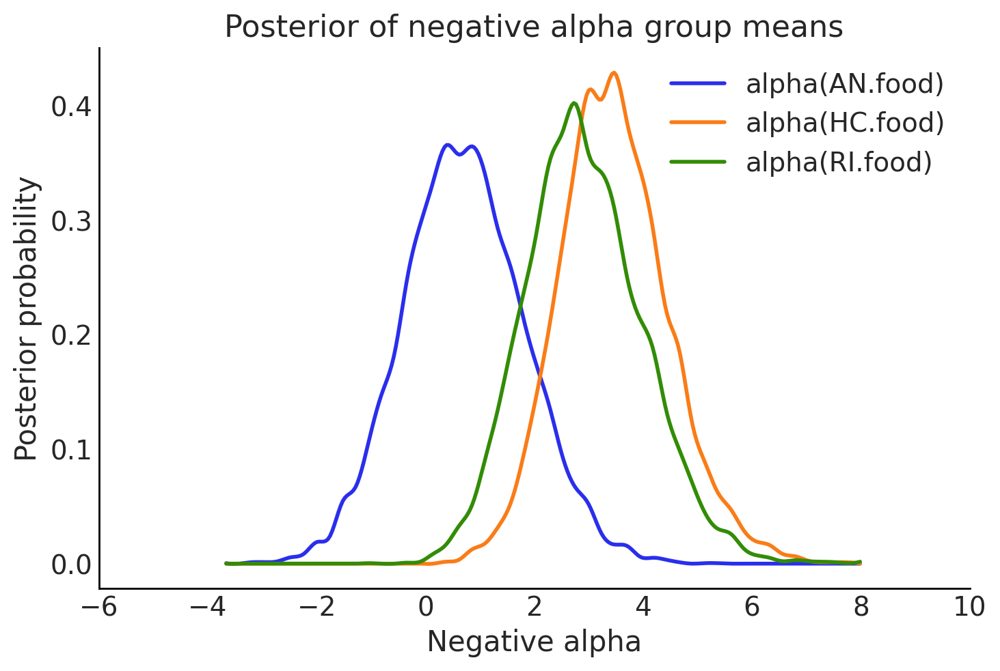

In [58]:
hddm.analyze.plot_posterior_nodes([alpha_an_f, alpha_hc_f, alpha_ri_f])
plt.xlabel("Negative alpha")
plt.ylabel("Posterior probability")
plt.title("Posterior of negative alpha group means")
plt.savefig("negative_alpha_group_means.pdf", pad_inches=4.5)
plt.xlim(-6, 10)


(-6.0, 10.0)

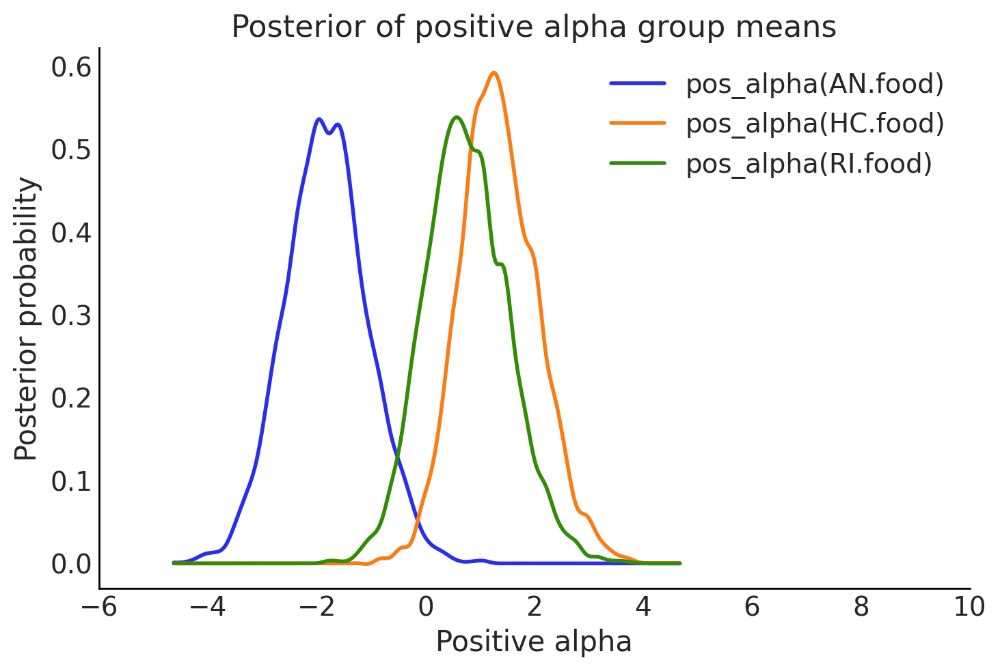

In [59]:
hddm.analyze.plot_posterior_nodes([pos_alpha_an_f, pos_alpha_hc_f, pos_alpha_ri_f])
plt.xlabel("Positive alpha")
plt.ylabel("Posterior probability")
plt.title("Posterior of positive alpha group means")
plt.savefig("positive_alpha_group_means.pdf", pad_inches=4.5)
plt.xlim(-6, 10)


(-4.0, 10.0)

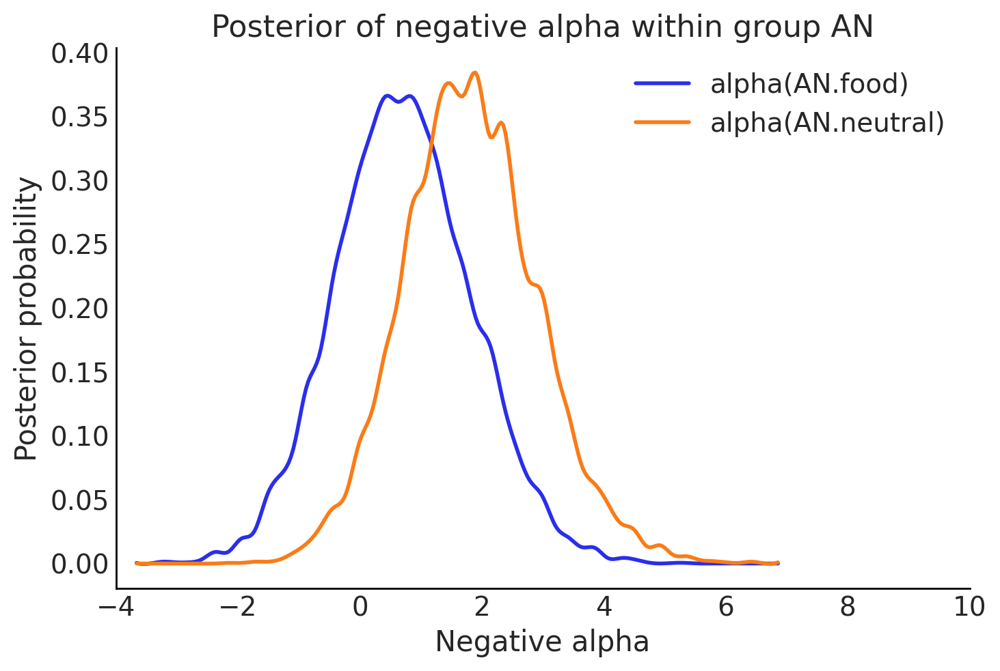

In [60]:
hddm.analyze.plot_posterior_nodes([alpha_an_f, alpha_an_n])
plt.xlabel("Negative alpha")
plt.ylabel("Posterior probability")
plt.title("Posterior of negative alpha within group AN")
plt.xlim(-4, 10)


(-4.0, 10.0)

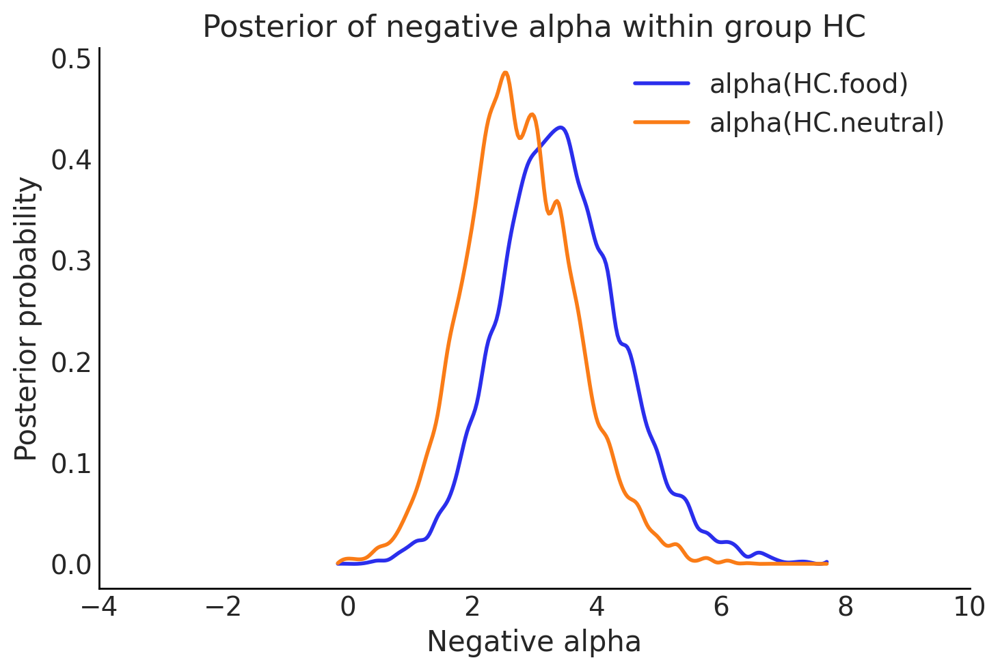

In [61]:
hddm.analyze.plot_posterior_nodes([alpha_hc_f, alpha_hc_n])
plt.xlabel("Negative alpha")
plt.ylabel("Posterior probability")
plt.title("Posterior of negative alpha within group HC")
plt.xlim(-4, 10)


(-4.0, 10.0)

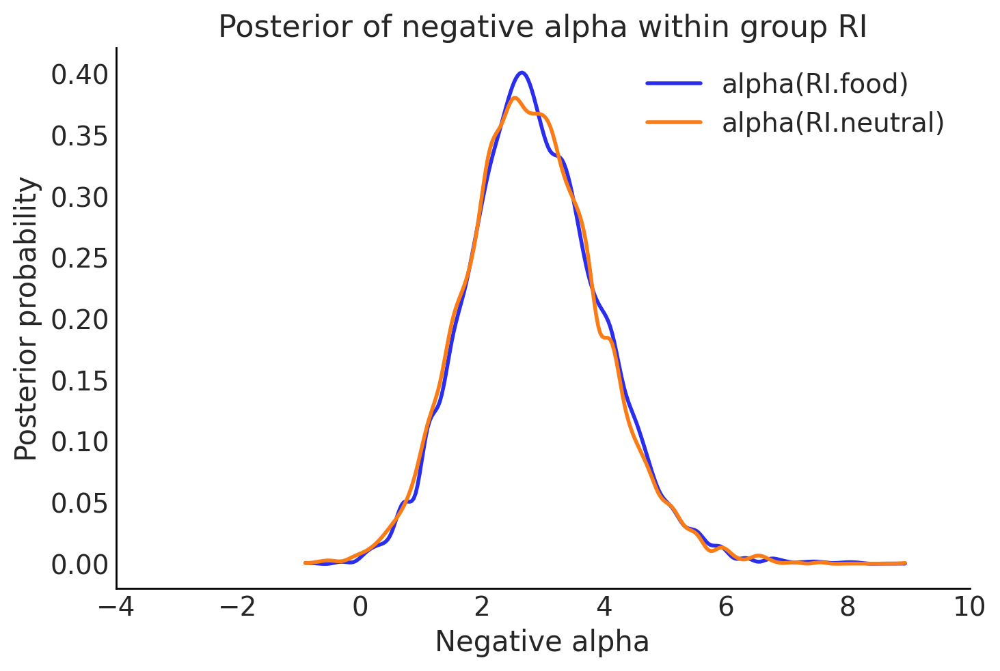

In [62]:
hddm.analyze.plot_posterior_nodes([alpha_ri_f, alpha_ri_n])
plt.xlabel("Negative alpha")
plt.ylabel("Posterior probability")
plt.title("Posterior of negative alpha within group RI")
plt.xlim(-4, 10)


(-6.0, 6.0)

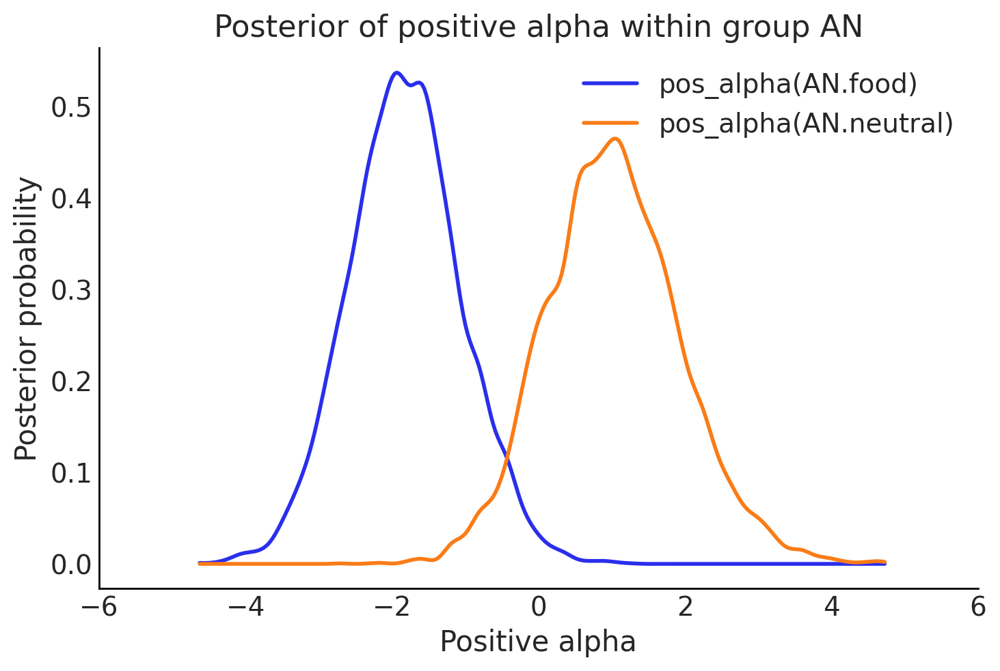

In [63]:
hddm.analyze.plot_posterior_nodes([pos_alpha_an_f, pos_alpha_an_n])
plt.xlabel("Positive alpha")
plt.ylabel("Posterior probability")
plt.title("Posterior of positive alpha within group AN")
plt.xlim(-6, 6)


(-6.0, 6.0)

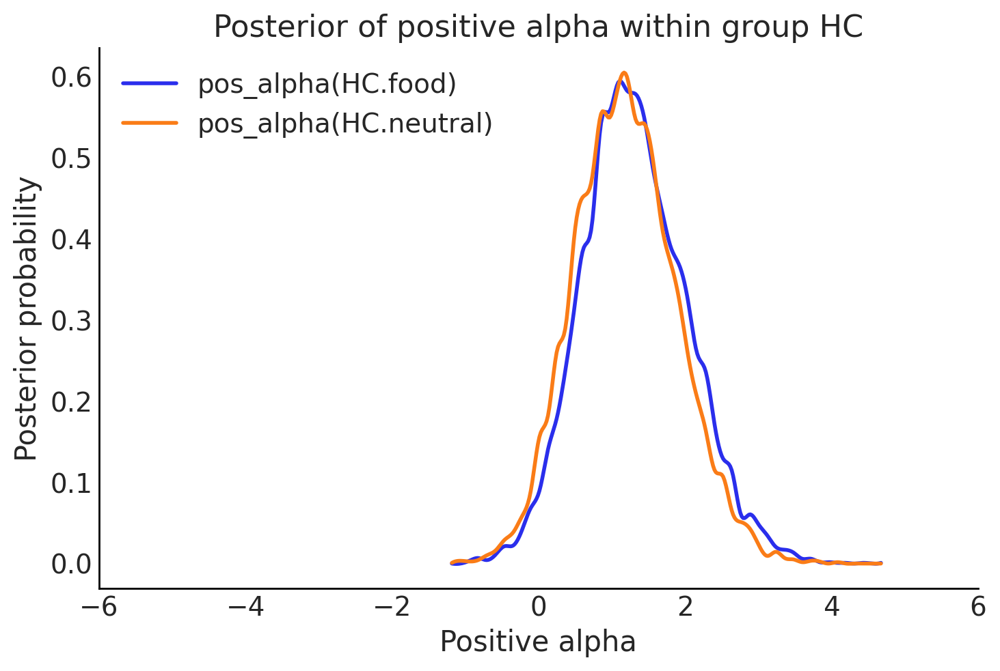

In [64]:
hddm.analyze.plot_posterior_nodes([pos_alpha_hc_f, pos_alpha_hc_n])
plt.xlabel("Positive alpha")
plt.ylabel("Posterior probability")
plt.title("Posterior of positive alpha within group HC")
plt.xlim(-6, 6)


(-6.0, 6.0)

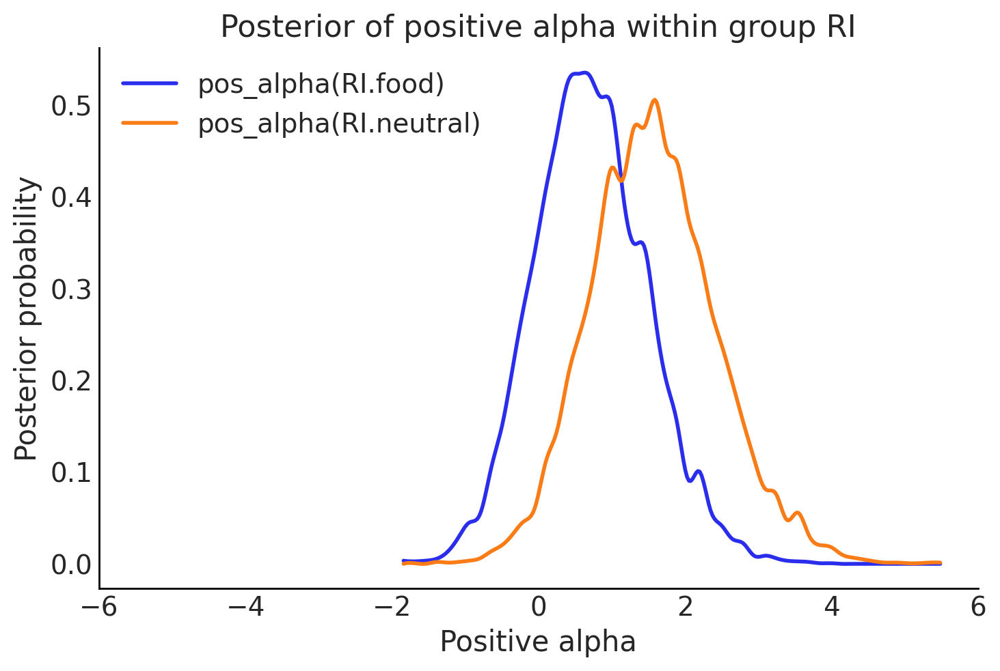

In [65]:
hddm.analyze.plot_posterior_nodes([pos_alpha_ri_f, pos_alpha_ri_n])
plt.xlabel("Positive alpha")
plt.ylabel("Posterior probability")
plt.title("Posterior of positive alpha within group RI")
plt.xlim(-6, 6)


### Between groups comparisons

In [66]:
print("Between-groups negative alpha\n")
print(
    "P(neg-alpha AN food > neg-alpha HC food) = ",
    (alpha_an_f.trace() > alpha_hc_f.trace()).mean(),
)
print(
    "P(neg-alpha AN food > neg-alpha RI food) = ",
    (alpha_an_f.trace() > alpha_ri_f.trace()).mean(),
)
print(
    "P(neg-alpha RI food > neg-alpha HC food) = ",
    (alpha_ri_f.trace() > alpha_hc_f.trace()).mean(),
)

print(
    "P(neg-alpha AN neutral > neg-alpha HC neutral) = ",
    (alpha_an_n.trace() > alpha_hc_n.trace()).mean(),
)
print(
    "P(neg-alpha AN neutral > neg-alpha RI neutral) = ",
    (alpha_an_n.trace() > alpha_ri_n.trace()).mean(),
)
print(
    "P(neg-alpha RI neutral > neg-alpha HC neutral) = ",
    (alpha_ri_n.trace() > alpha_hc_n.trace()).mean(),
)

print("\nBetween-groups positive alpha\n")
print(
    "P(pos-alpha AN food > pos-alpha HC food) = ",
    (pos_alpha_an_f.trace() > pos_alpha_hc_f.trace()).mean(),
)
print(
    "P(pos-alpha AN food > pos-alpha RI food) = ",
    (pos_alpha_an_f.trace() > pos_alpha_ri_f.trace()).mean(),
)
print(
    "P(pos-alpha RI food > pos-alpha HC food) = ",
    (pos_alpha_ri_f.trace() > pos_alpha_hc_f.trace()).mean(),
)

print(
    "P(pos-alpha AN neutral > pos-alpha HC neutral) = ",
    (pos_alpha_an_n.trace() > pos_alpha_hc_n.trace()).mean(),
)
print(
    "P(pos-alpha AN neutral > pos-alpha RI neutral) = ",
    (pos_alpha_an_n.trace() > pos_alpha_ri_n.trace()).mean(),
)
print(
    "P(pos-alpha RI neutral > pos-alpha HC neutral) = ",
    (pos_alpha_ri_n.trace() > pos_alpha_hc_n.trace()).mean(),
)

Between-groups negative alpha

P(neg-alpha AN food > neg-alpha HC food) =  0.0274
P(neg-alpha AN food > neg-alpha RI food) =  0.0732
P(neg-alpha RI food > neg-alpha HC food) =  0.3454
P(neg-alpha AN neutral > neg-alpha HC neutral) =  0.238
P(neg-alpha AN neutral > neg-alpha RI neutral) =  0.2408
P(neg-alpha RI neutral > neg-alpha HC neutral) =  0.523

Between-groups positive alpha

P(pos-alpha AN food > pos-alpha HC food) =  0.0009
P(pos-alpha AN food > pos-alpha RI food) =  0.0085
P(pos-alpha RI food > pos-alpha HC food) =  0.2755
P(pos-alpha AN neutral > pos-alpha HC neutral) =  0.4325
P(pos-alpha AN neutral > pos-alpha RI neutral) =  0.3232
P(pos-alpha RI neutral > pos-alpha HC neutral) =  0.6338


### Within-group comparisons

In [67]:
print("Within-group negative alpha\n")
print(
    "P(neg-alpha AN food > neg-alpha AN neutral) = ",
    (alpha_an_f.trace() > alpha_an_n.trace()).mean(),
)
print(
    "P(neg-alpha HC food > neg-alpha HC neutral) = ",
    (alpha_hc_f.trace() > alpha_hc_n.trace()).mean(),
)
print(
    "P(neg-alpha RI food > neg-alpha RI neutral) = ",
    (alpha_ri_f.trace() > alpha_ri_n.trace()).mean(),
)

print("\nWithin-group positive alpha\n")
print(
    "P(pos-alpha AN food > pos-alpha AN neutral) = ",
    (pos_alpha_an_f.trace() > pos_alpha_an_n.trace()).mean(),
)
print(
    "P(pos-alpha HC food > pos-alpha HC neutral) = ",
    (pos_alpha_hc_f.trace() > pos_alpha_hc_n.trace()).mean(),
)
print(
    "P(pos-alpha RI food > pos-alpha RI neutral) = ",
    (pos_alpha_ri_f.trace() > pos_alpha_ri_n.trace()).mean(),
)


Within-group negative alpha

P(neg-alpha AN food > neg-alpha AN neutral) =  0.2349
P(neg-alpha HC food > neg-alpha HC neutral) =  0.6993
P(neg-alpha RI food > neg-alpha RI neutral) =  0.5101

Within-group positive alpha

P(pos-alpha AN food > neg-alpha AN neutral) =  0.0098
P(pos-alpha HC food > pos-alpha HC neutral) =  0.5544
P(pos-alpha RI food > pos-alpha RI neutral) =  0.2247


In [68]:
print("Between-stimuli negative alpha\n")
print(
    "P(neg-alpha AN food > neg-alpha HC food) = ",
    (alpha_an_f.trace() > alpha_hc_f.trace()).mean(),
)
print(
    "P(neg-alpha AN food > neg-alpha RI food) = ",
    (alpha_an_f.trace() > alpha_ri_f.trace()).mean(),
)
print(
    "P(neg-alpha RI food > neg-alpha HC food) = ",
    (alpha_ri_f.trace() > alpha_hc_f.trace()).mean(),
)

print(
    "P(neg-alpha AN neutral > neg-alpha HC neutral) = ",
    (alpha_an_n.trace() > alpha_hc_n.trace()).mean(),
)
print(
    "P(neg-alpha AN neutral > neg-alpha RI neutral) = ",
    (alpha_an_n.trace() > alpha_ri_n.trace()).mean(),
)
print(
    "P(neg-alpha RI neutral > neg-alpha HC neutral) = ",
    (alpha_ri_n.trace() > alpha_hc_n.trace()).mean(),
)

Between-stimuli negative alpha

P(neg-alpha AN food > neg-alpha HC food) =  0.0274
P(neg-alpha AN food > neg-alpha RI food) =  0.0732
P(neg-alpha RI food > neg-alpha HC food) =  0.3454
P(neg-alpha AN neutral > neg-alpha HC neutral) =  0.238
P(neg-alpha AN neutral > neg-alpha RI neutral) =  0.2408
P(neg-alpha RI neutral > neg-alpha HC neutral) =  0.523


## Drift rate

In [69]:
(
    v_an_f,
    v_an_n,
    v_hc_f,
    v_hc_n,
    v_ri_f,
    v_ri_n,
) = m8.nodes_db.node[
    [
        "v(AN.food)",
        "v(AN.neutral)",
        "v(HC.food)",
        "v(HC.neutral)",
        "v(RI.food)",
        "v(RI.neutral)",
    ]
]

(0.1, 3.5)

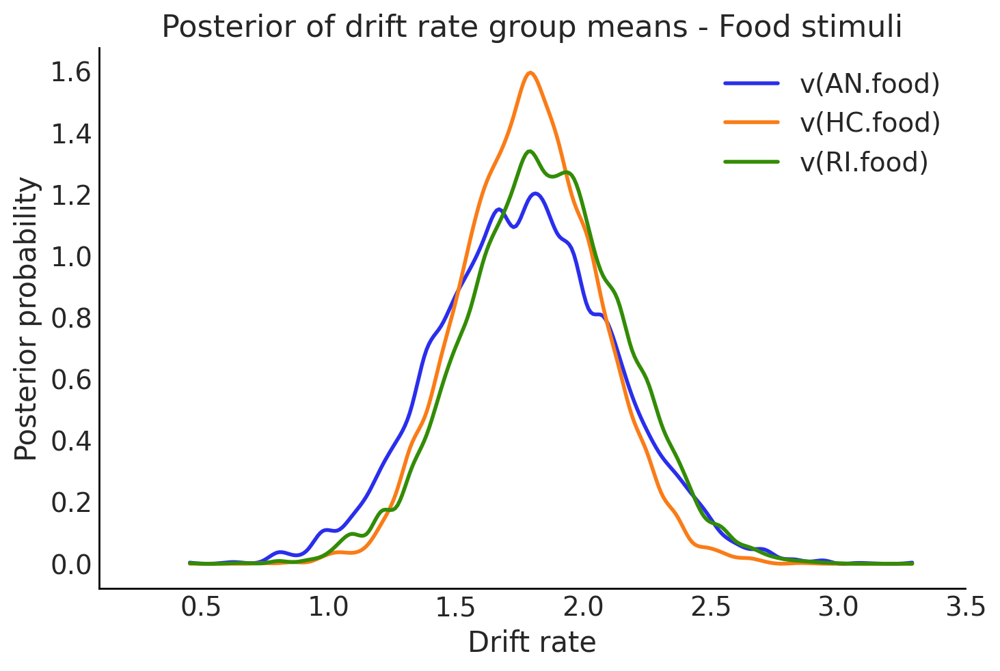

In [70]:
hddm.analyze.plot_posterior_nodes([v_an_f, v_hc_f, v_ri_f])
plt.xlabel("Drift rate")
plt.ylabel("Posterior probability")
plt.title("Posterior of drift rate group means - Food stimuli")
plt.xlim(0.1, 3.5)


(0.1, 3.5)

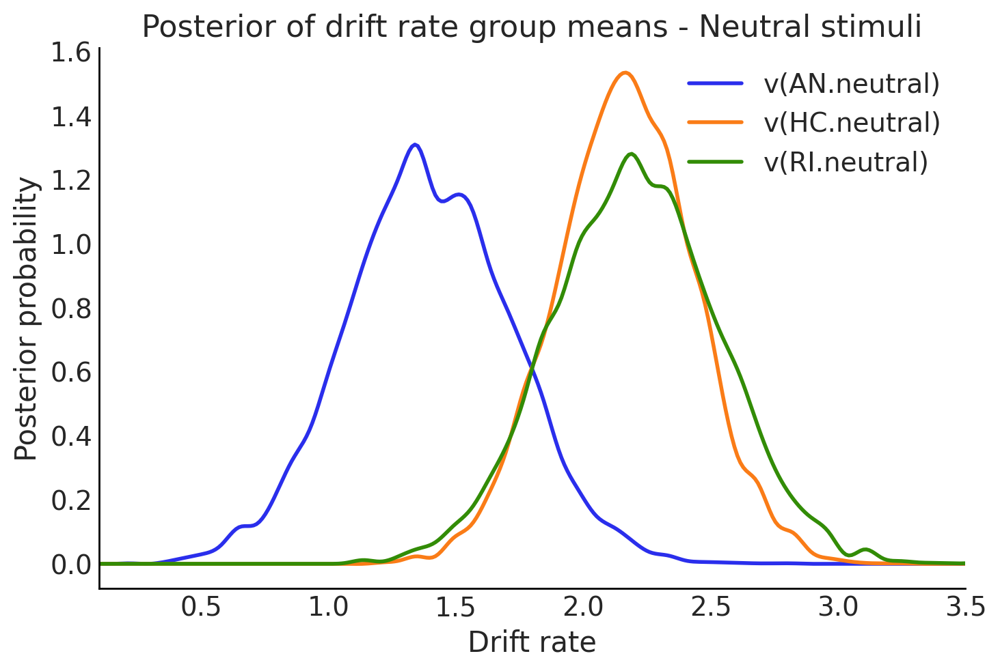

In [71]:
hddm.analyze.plot_posterior_nodes([v_an_n, v_hc_n, v_ri_n])
plt.xlabel("Drift rate")
plt.ylabel("Posterior probability")
plt.title("Posterior of drift rate group means - Neutral stimuli")
plt.xlim(0.1, 3.5)


### Between-groups comparisons

In [72]:
print("Between-groups drift rate\n")
print(
    "P(v AN food > v HC food) = ",
    (v_an_f.trace() > v_hc_f.trace()).mean(),
)
print(
    "P(v AN food > v RI food) = ",
    (v_an_f.trace() > v_ri_f.trace()).mean(),
)
print(
    "P(v RI food > v HC food) = ",
    (v_ri_f.trace() > v_hc_f.trace()).mean(),
)

print(
    "P(v AN neutral > v HC neutral) = ",
    (v_an_n.trace() > v_hc_n.trace()).mean(),
)
print(
    "P(v AN neutral > v RI neutral) = ",
    (v_an_n.trace() > v_ri_n.trace()).mean(),
)
print(
    "P(v RI neutral > v HC neutral) = ",
    (v_ri_n.trace() > v_hc_n.trace()).mean(),
)


Between-groups drift rate

P(v AN food > v HC food) =  0.4883
P(v AN food > v RI food) =  0.4398
P(v RI food > v HC food) =  0.5587
P(v AN neutral > v HC neutral) =  0.0344
P(v AN neutral > v RI neutral) =  0.0392
P(v RI neutral > v HC neutral) =  0.5359


### Within-group comparisons

In [73]:
print("Within-group drift rate\n")
print(
    "P(v AN food > v AN neutral) = ",
    (v_an_f.trace() > v_an_n.trace()).mean(),
)
print(
    "P(v HC food > v HC neutral) = ",
    (v_hc_f.trace() > v_hc_n.trace()).mean(),
)
print(
    "P(v RI food > v RI neutral) = ",
    (v_ri_f.trace() > v_ri_n.trace()).mean(),
)

Within-group drift rate

P(v AN food > v AN neutral) =  0.7907
P(v HC food > v HC neutral) =  0.1606
P(v RI food > v RI neutral) =  0.2133


## Decision threshold

In [74]:
(
    a_an_f,
    a_an_n,
    a_hc_f,
    a_hc_n,
    a_ri_f,
    a_ri_n,
) = m8.nodes_db.node[
    [
        "a(AN.food)",
        "a(AN.neutral)",
        "a(HC.food)",
        "a(HC.neutral)",
        "a(RI.food)",
        "a(RI.neutral)",
    ]
]

(1.1, 1.6)

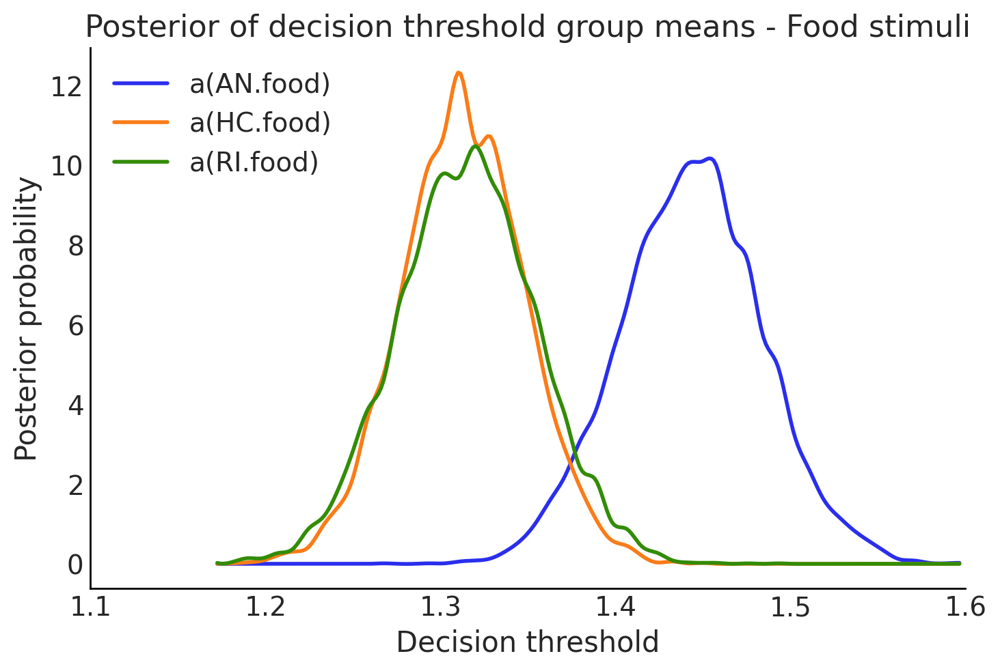

In [75]:
hddm.analyze.plot_posterior_nodes([a_an_f, a_hc_f, a_ri_f])
plt.xlabel("Decision threshold")
plt.ylabel("Posterior probability")
plt.title("Posterior of decision threshold group means - Food stimuli")
plt.xlim(1.10, 1.6)


(1.1, 1.6)

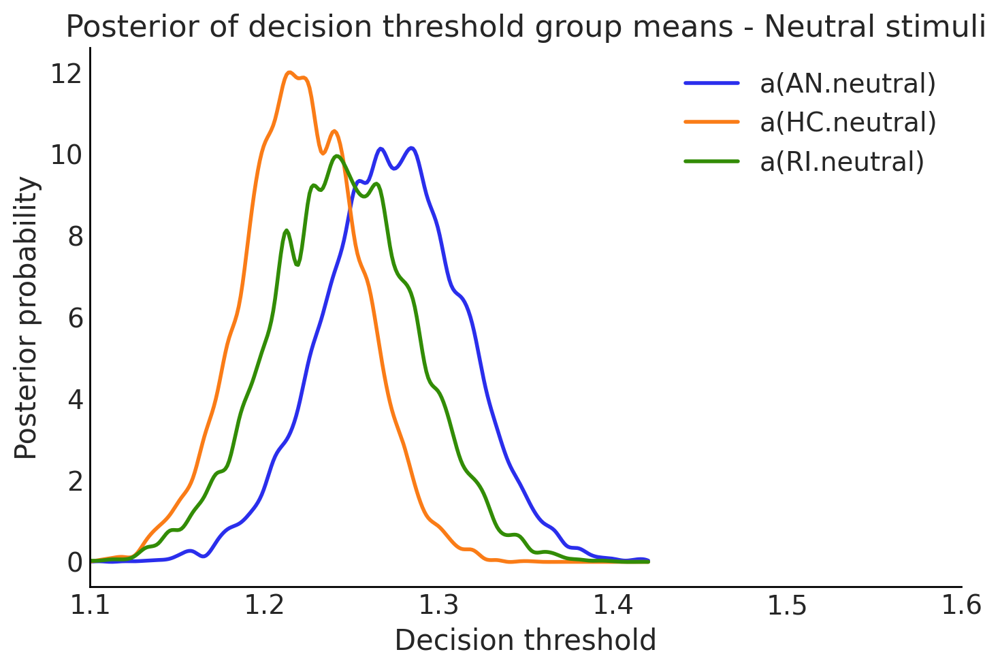

In [76]:
hddm.analyze.plot_posterior_nodes([a_an_n, a_hc_n, a_ri_n])
plt.xlabel("Decision threshold")
plt.ylabel("Posterior probability")
plt.title("Posterior of decision threshold group means - Neutral stimuli")
plt.xlim(1.10, 1.6)


### Between-groups comparisons

In [77]:
print("Between-groups decision threshold\n")
print(
    "P(a AN food > a HC food) = ",
    (a_an_f.trace() > a_hc_f.trace()).mean(),
)
print(
    "P(a AN food > a RI food) = ",
    (a_an_f.trace() > a_ri_f.trace()).mean(),
)
print(
    "P(a RI food > a HC food) = ",
    (a_ri_f.trace() > a_hc_f.trace()).mean(),
)

print(
    "P(a AN neutral > a HC neutral) = ",
    (a_an_n.trace() > a_hc_n.trace()).mean(),
)
print(
    "P(a AN neutral > a RI neutral) = ",
    (a_an_n.trace() > a_ri_n.trace()).mean(),
)
print(
    "P(a RI neutral > a HC neutral) = ",
    (a_ri_n.trace() > a_hc_n.trace()).mean(),
)

Between-groups decision threshold

P(a AN food > a HC food) =  0.9932
P(a AN food > a RI food) =  0.9882
P(a RI food > a HC food) =  0.5157
P(a AN neutral > a HC neutral) =  0.8379
P(a AN neutral > a RI neutral) =  0.6894
P(a RI neutral > a HC neutral) =  0.6684


### Within-group comparisons

In [78]:
print("Within-group decision threshold\n")
print(
    "P(a AN food < a AN neutral) = ",
    (a_an_f.trace() < a_an_n.trace()).mean(),
)
print(
    "P(a HC food < a HC neutral) = ",
    (a_hc_f.trace() < a_hc_n.trace()).mean(),
)
print(
    "P(a RI food < a RI neutral) = ",
    (a_ri_f.trace() < a_ri_n.trace()).mean(),
)

Within-group decision threshold

P(a AN food < a AN neutral) =  0.0013
P(a HC food < a HC neutral) =  0.0256
P(a RI food < a RI neutral) =  0.1026


## Non decison time

In [79]:
(
    t_an_f,
    t_an_n,
    t_hc_f,
    t_hc_n,
    t_ri_f,
    t_ri_n,
) = m8.nodes_db.node[
    [
        "t(AN.food)",
        "t(AN.neutral)",
        "t(HC.food)",
        "t(HC.neutral)",
        "t(RI.food)",
        "t(RI.neutral)",
    ]
]

(0.13, 0.24)

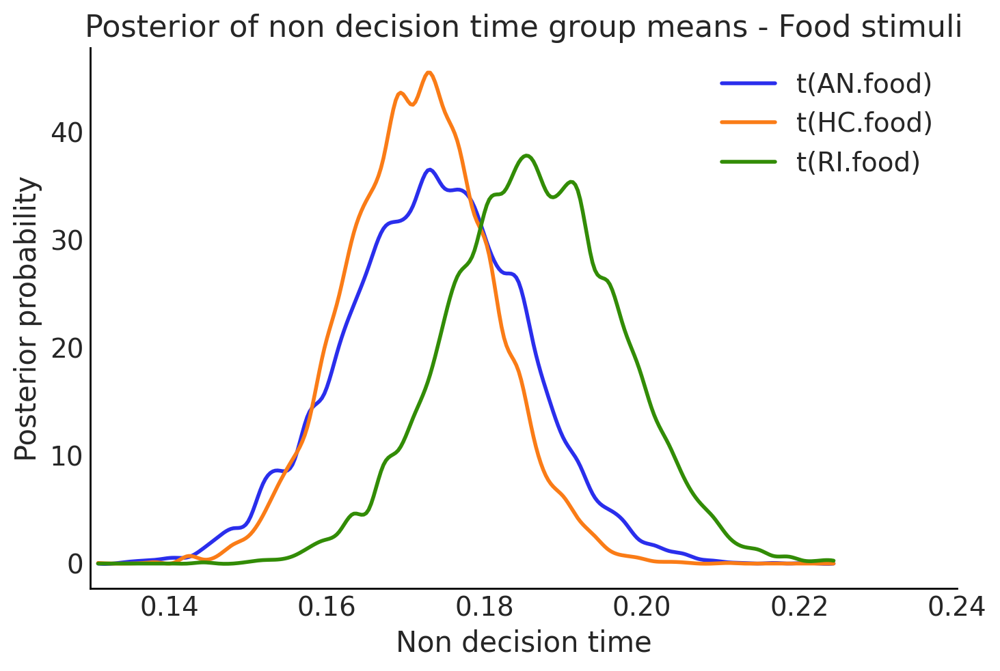

In [80]:
hddm.analyze.plot_posterior_nodes([t_an_f, t_hc_f, t_ri_f])
plt.xlabel("Non decision time")
plt.ylabel("Posterior probability")
plt.title("Posterior of non decision time group means - Food stimuli")
plt.xlim(0.13, 0.24)


(0.13, 0.24)

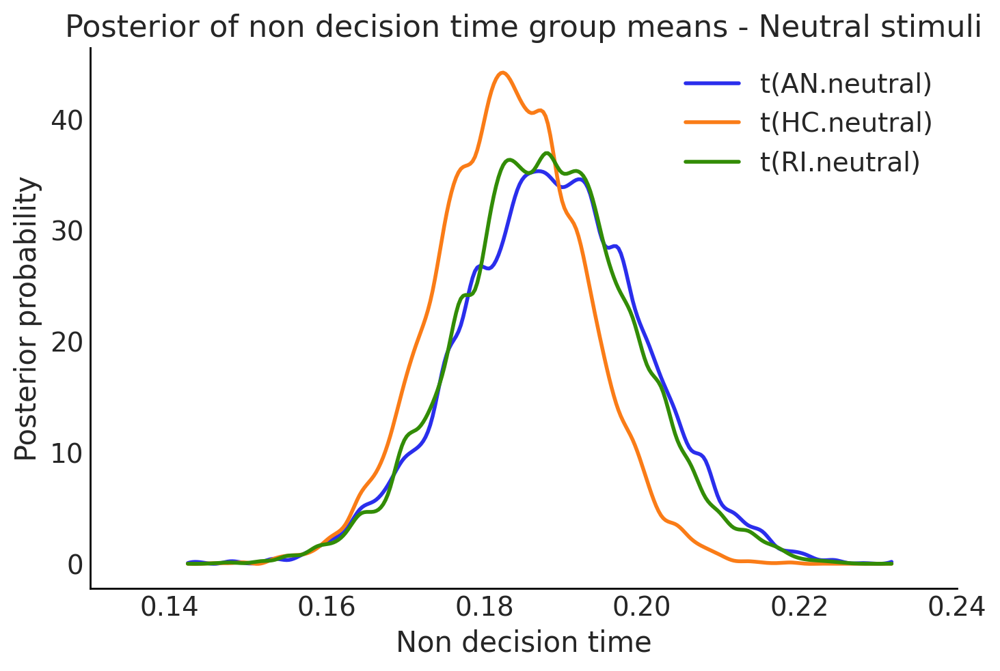

In [81]:
hddm.analyze.plot_posterior_nodes([t_an_n, t_hc_n, t_ri_n])
plt.xlabel("Non decision time")
plt.ylabel("Posterior probability")
plt.title("Posterior of non decision time group means - Neutral stimuli")
plt.xlim(0.13, 0.24)


### Between groups comparisons

In [82]:
print("Between-groups non decision time\n")
print(
    "P(t AN food > t HC food) = ",
    (t_an_f.trace() > t_hc_f.trace()).mean(),
)
print(
    "P(t AN food > t RI food) = ",
    (t_an_f.trace() > t_ri_f.trace()).mean(),
)
print(
    "P(t RI food > t HC food) = ",
    (t_ri_f.trace() > t_hc_f.trace()).mean(),
)

print(
    "P(t AN neutral > t HC neutral) = ",
    (t_an_n.trace() > t_hc_n.trace()).mean(),
)
print(
    "P(t AN neutral > t RI neutral) = ",
    (t_an_n.trace() > t_ri_n.trace()).mean(),
)
print(
    "P(t RI neutral > t HC neutral) = ",
    (t_ri_n.trace() > t_hc_n.trace()).mean(),
)

Between-groups non decision time

P(t AN food > t HC food) =  0.5585
P(t AN food > t RI food) =  0.1994
P(t RI food > t HC food) =  0.8587
P(t AN neutral > t HC neutral) =  0.6472
P(t AN neutral > t RI neutral) =  0.5182
P(t RI neutral > t HC neutral) =  0.6243


### Within-group comparisons

In [83]:
print("Within-group non decision time\n")
print(
    "P(t AN food < t AN neutral) = ",
    (t_an_f.trace() < t_an_n.trace()).mean(),
)
print(
    "P(t HC food < t HC neutral) = ",
    (t_hc_f.trace() < t_hc_n.trace()).mean(),
)
print(
    "P(t RI food < t RI neutral) = ",
    (t_ri_f.trace() < t_ri_n.trace()).mean(),
)

Within-group non decision time

P(t AN food < t AN neutral) =  0.8311
P(t HC food < t HC neutral) =  0.8228
P(t RI food < t RI neutral) =  0.5462


## Print fitted parameters and other model statistics


In [84]:
m8.print_stats()

                                    mean       std       2.5q       25q       50q       75q      97.5q    mc err
a(AN.food)                      1.442126  0.039944   1.362797  1.415049  1.442569  1.468798   1.521845  0.000443
a(AN.neutral)                   1.273304  0.039517   1.195572  1.247107  1.273442  1.299944    1.35007  0.000419
a(HC.food)                      1.314466  0.034553   1.245745   1.29142   1.31427  1.337782    1.38252  0.000388
a(HC.neutral)                   1.222156  0.033504   1.155204   1.20002  1.221891  1.245019   1.287461  0.000401
a(RI.food)                      1.316264  0.039083   1.239556  1.290122  1.316626  1.342447   1.392733  0.000418
a(RI.neutral)                   1.245196  0.041076   1.163901  1.217157  1.245006  1.272768   1.325373   0.00047
a_std                           0.228036  0.012144   0.205445  0.219589   0.22775  0.235801   0.253194   0.00017
a_subj(AN.food).1               1.270092  0.056428    1.16255   1.23171   1.26912  1.307469   1.

## Checking results


Plotting a(AN.food)
Plotting a(AN.neutral)
Plotting a(HC.food)
Plotting a(HC.neutral)
Plotting a(RI.food)
Plotting a(RI.neutral)
Plotting a_std
Plotting v(AN.food)
Plotting v(AN.neutral)
Plotting v(HC.food)
Plotting v(HC.neutral)
Plotting v(RI.food)
Plotting v(RI.neutral)
Plotting v_std
Plotting t(AN.food)
Plotting t(AN.neutral)
Plotting t(HC.food)
Plotting t(HC.neutral)
Plotting t(RI.food)
Plotting t(RI.neutral)
Plotting t_std


/Users/corrado/mambaforge/envs/py37_env/lib/python3.7/site-packages/pymc/Matplot.py:432: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figure(figsize=(10, 6))


Plotting alpha(AN.food)
Plotting alpha(AN.neutral)
Plotting alpha(HC.food)
Plotting alpha(HC.neutral)
Plotting alpha(RI.food)
Plotting alpha(RI.neutral)
Plotting alpha_std
Plotting pos_alpha(AN.food)
Plotting pos_alpha(AN.neutral)
Plotting pos_alpha(HC.food)
Plotting pos_alpha(HC.neutral)
Plotting pos_alpha(RI.food)
Plotting pos_alpha(RI.neutral)
Plotting pos_alpha_std


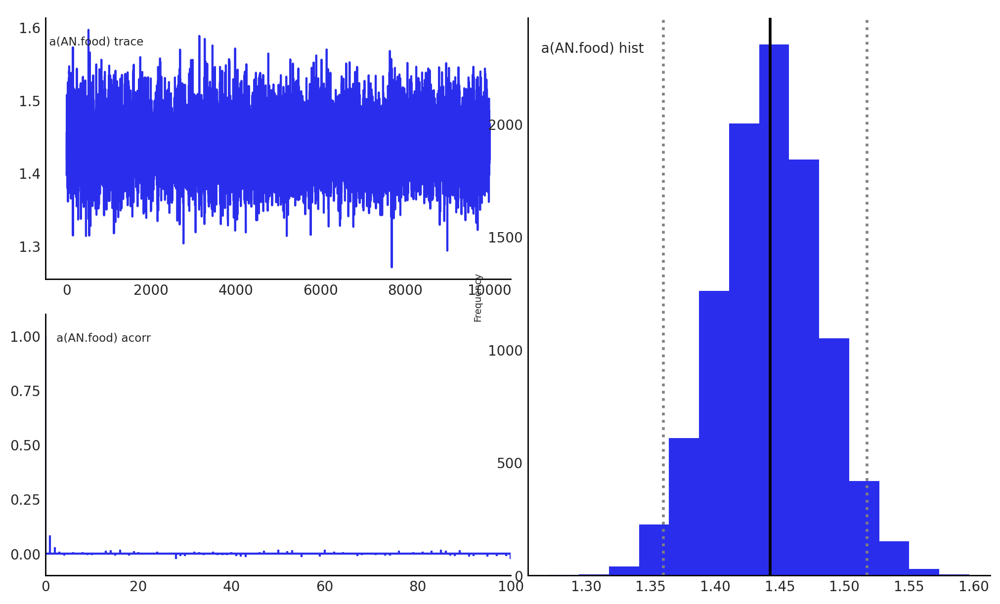

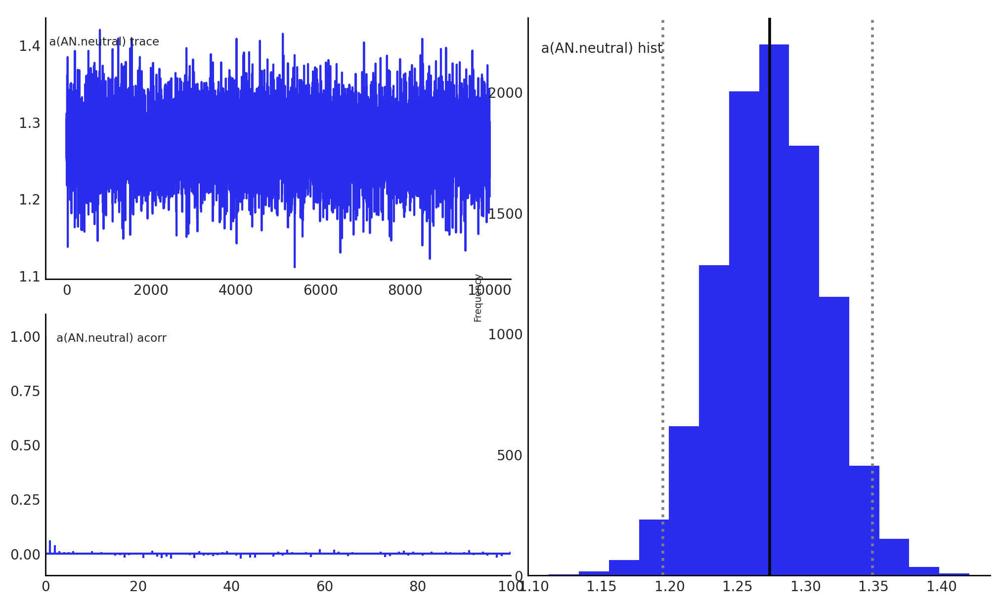

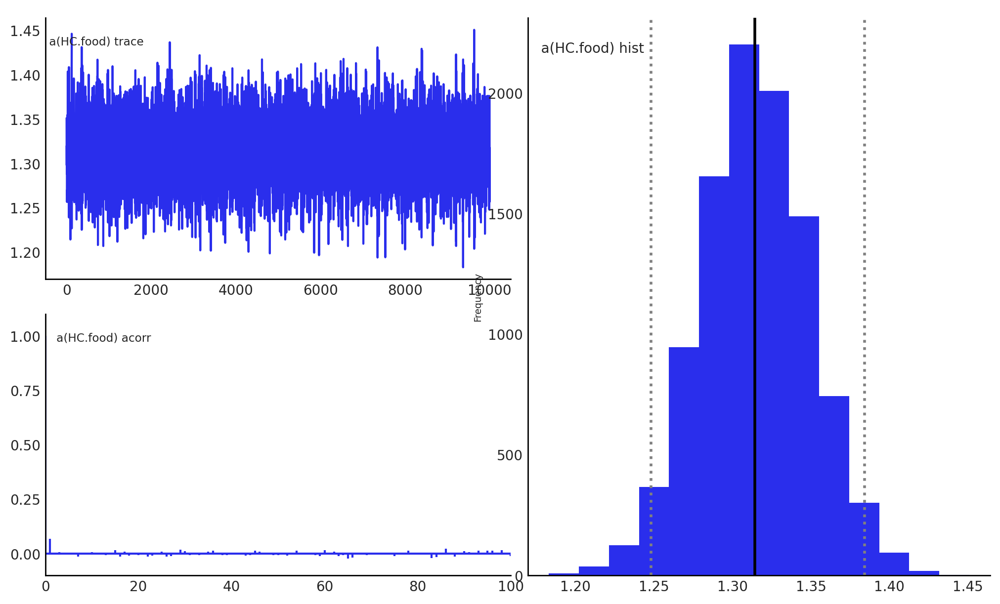

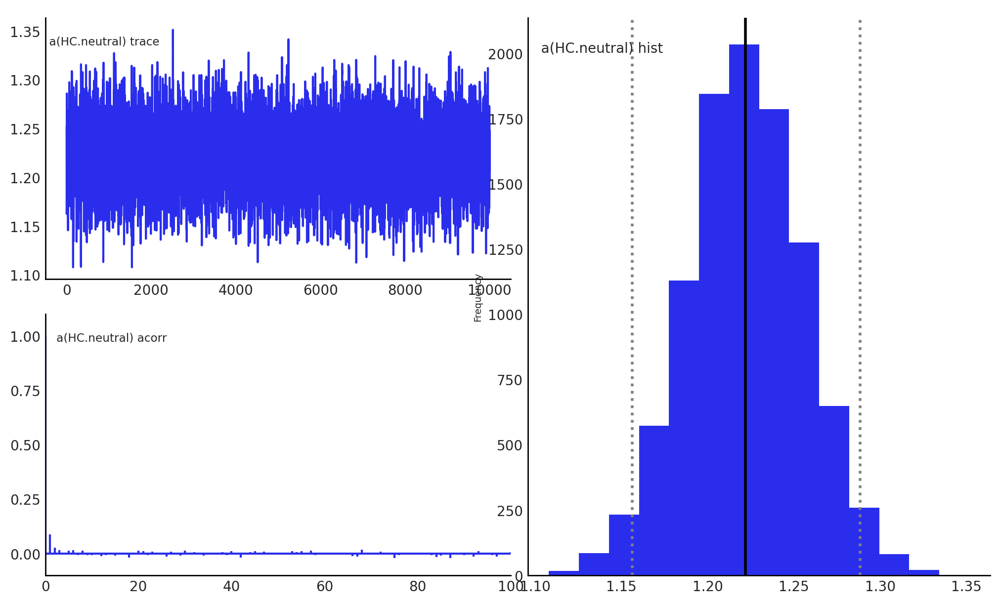

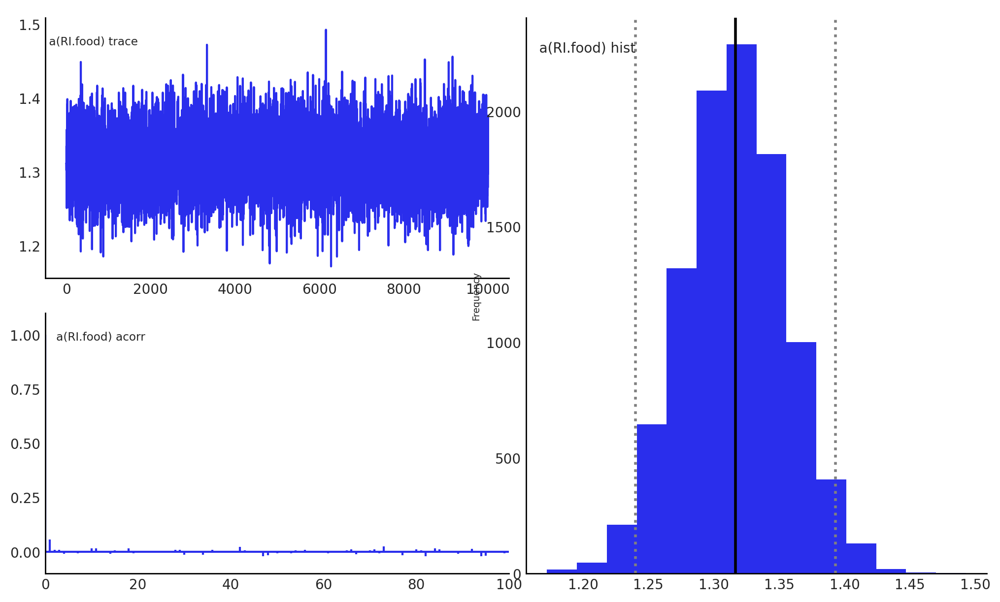

...

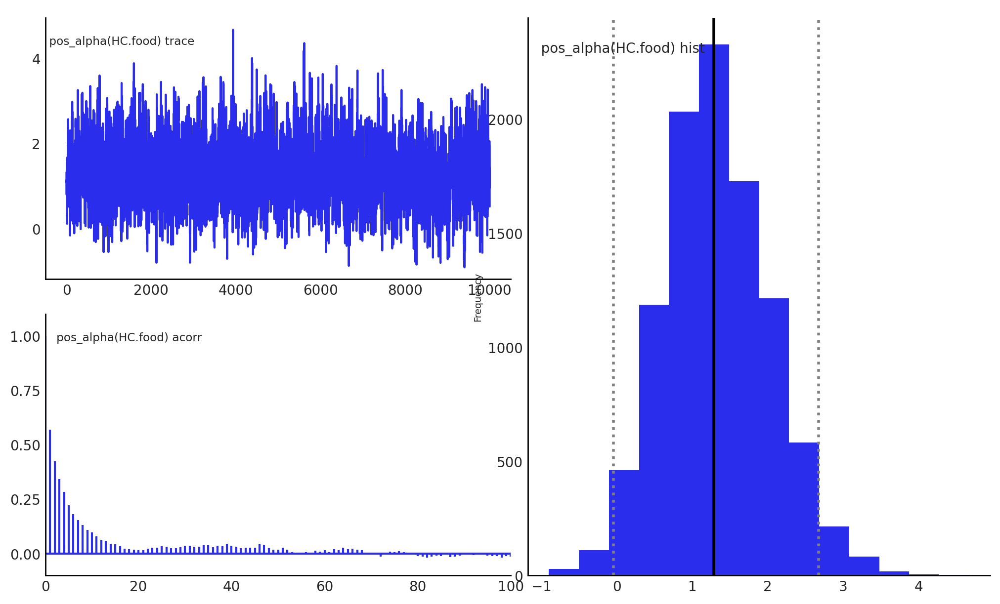

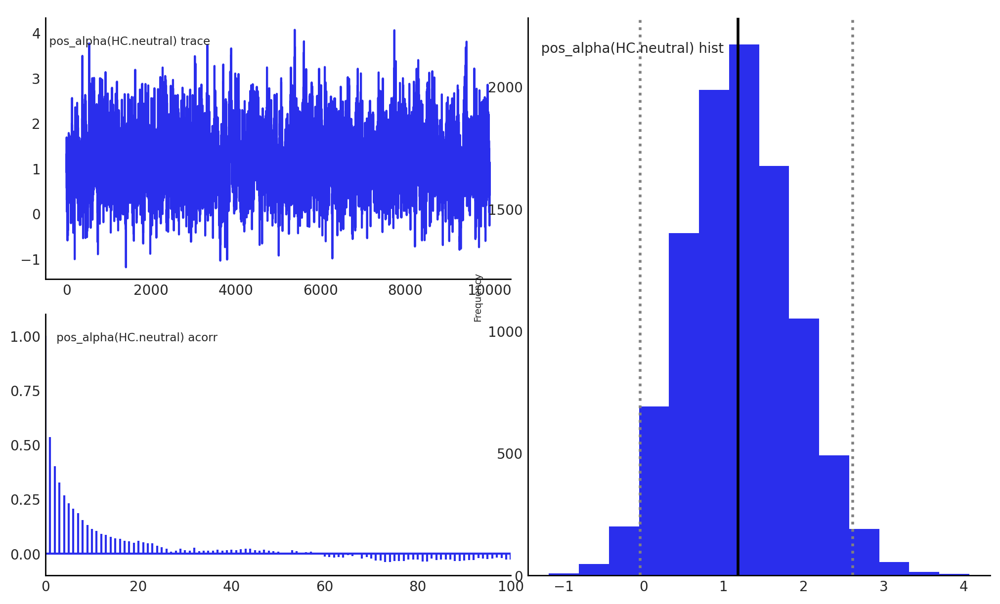

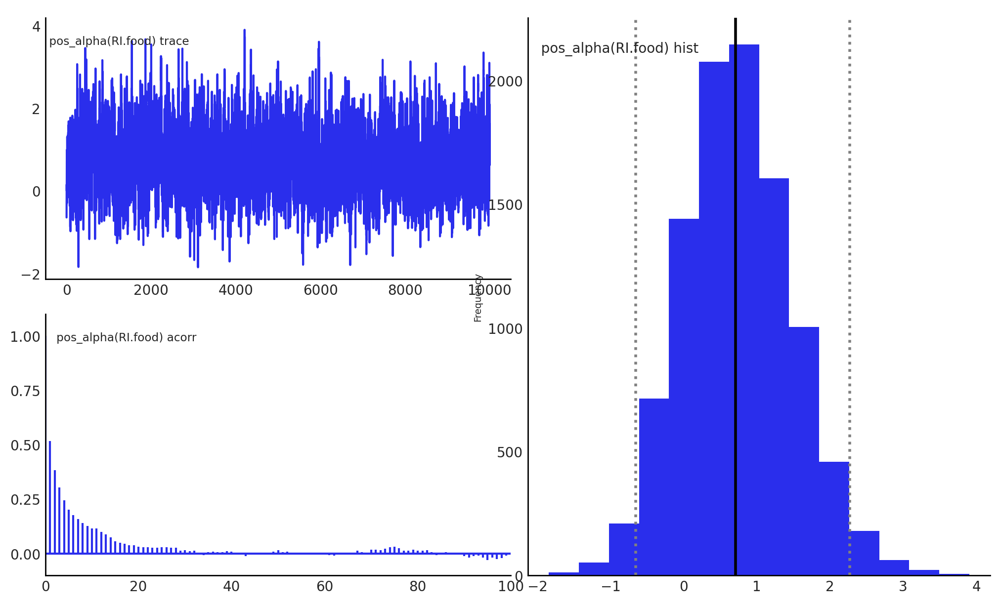

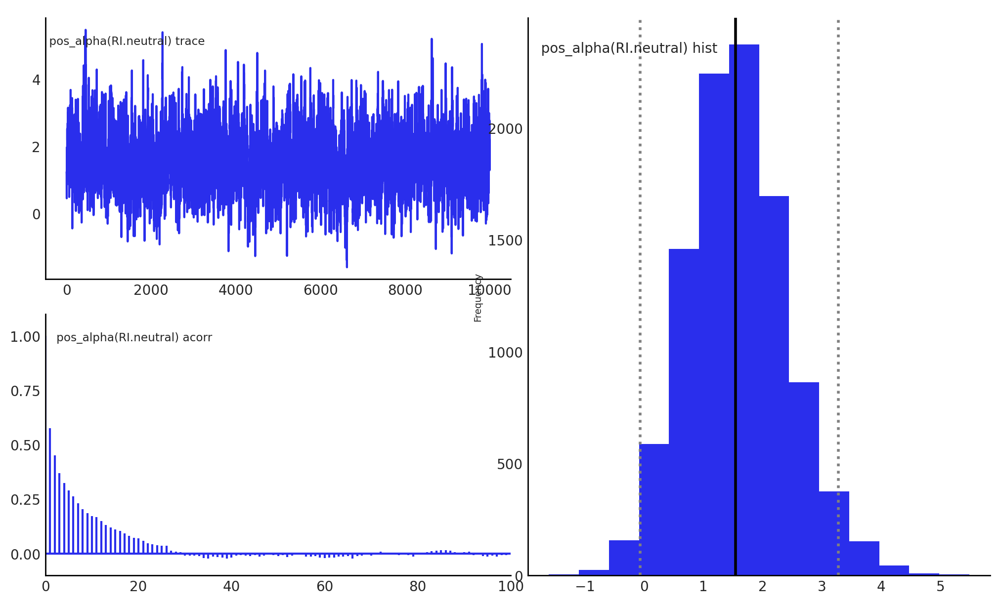

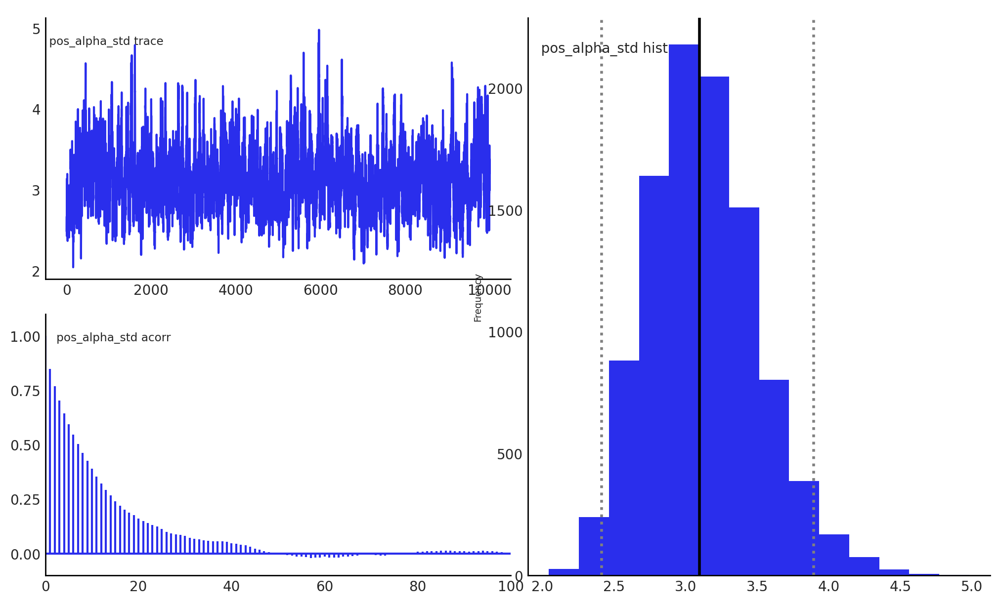

In [85]:
m8.plot_posteriors()

## Estimate convergence

In [86]:
models = []
for i in range(3):
    m = hddm.HDDMrl(
        data,
        # bias=True,
        depends_on={
            "a": ["diag_cat", "stim"],
            "v": ["diag_cat", "stim"],
            "t": ["diag_cat", "stim"],
            "alpha": ["diag_cat", "stim"],
            "pos_alpha": ["diag_cat", "stim"],
        },
        dual=True,  # separate learning rates for pos/neg feedbacks
        p_outlier=0.05,
        informative=True,  # informative priors on ddm params
        include=["v", "a", "t"],
    )
    m.sample(3000, burn=1500, dbname="traces_conv.db", db="pickle")
    models.append(m)

No model attribute --> setting up standard HDDM
Set model to ddm
 [-----------------100%-----------------] 3001 of 3000 complete in 2396.8 secNo model attribute --> setting up standard HDDM
Set model to ddm
 [-----------------100%-----------------] 3001 of 3000 complete in 8129.3 secNo model attribute --> setting up standard HDDM
Set model to ddm
 [-----------------100%-----------------] 3001 of 3000 complete in 3471.1 sec

In [87]:
gel_rub = gelman_rubin(models)
str(gel_rub)

"{'a(AN.food)': 0.9996734189644878, 'a(AN.neutral)': 0.9998147850139651, 'a(HC.food)': 1.0002872684698088, 'a(HC.neutral)': 0.9999362652667815, 'a(RI.food)': 0.9996837142554947, 'a(RI.neutral)': 1.0006242342338185, 'a_std': 0.9996848556065844, 'a_subj(AN.food).1': 1.000237203679697, 'a_subj(AN.food).4': 1.0015713835552866, 'a_subj(AN.food).5': 1.0014941379484927, 'a_subj(AN.food).7': 1.0011483973188835, 'a_subj(AN.food).8': 1.0022640945314705, 'a_subj(AN.food).9': 1.0001991196485762, 'a_subj(AN.food).10': 1.000091490501757, 'a_subj(AN.food).12': 1.000740976582519, 'a_subj(AN.food).13': 1.0000310543771982, 'a_subj(AN.food).14': 1.0018121917455707, 'a_subj(AN.food).15': 0.9998096474889163, 'a_subj(AN.food).16': 1.0011137548782942, 'a_subj(AN.food).17': 1.000954794251072, 'a_subj(AN.food).19': 0.9996807874146031, 'a_subj(AN.food).21': 0.9997600921638284, 'a_subj(AN.food).22': 1.0000378613554093, 'a_subj(AN.food).23': 1.000619350151932, 'a_subj(AN.food).24': 0.9997221268720017, 'a_subj(AN.

In [88]:
np.max(list(gelman_rubin(models).values()))

1.0251510298472417

In [89]:
np.mean(list(gelman_rubin(models).values()))

1.0015692187185061

In [90]:
# Combine the models we ran to test for convergence.
m = kabuki.utils.concat_models(models)

## Collinearity

Another test of the model is to look at collinearity. If the estimation of parameters is very codependent (correlation is strong) it can indicate that their variance trades off, in particular if there is a negative correlation. The following plot shows there is generally low correlation across all combinations of parameters. It does not seem to be the case for this dataset, but common for RLDDM is a negative correlation between learning rate and the scaling factor, similar to what’s usually observed between learning rate and inverse temperature for RL models that uses softmax as the choice rule (e.g. Daw, 2011).

In [91]:
(
    alpha_an_f,
    alpha_an_n,
    alpha_hc_f,
    alpha_hc_n,
    alpha_ri_f,
    alpha_ri_n,
    pos_alpha_an_f,
    pos_alpha_an_n,
    pos_alpha_hc_f,
    pos_alpha_hc_n,
    pos_alpha_ri_f,
    pos_alpha_ri_n,
    t_an_f,
    t_an_n,
    t_hc_f,
    t_hc_n,
    t_ri_f,
    t_ri_n,
    a_an_f,
    a_an_n,
    a_hc_f,
    a_hc_n,
    a_ri_f,
    a_ri_n,
    v_an_f,
    v_an_n,
    v_hc_f,
    v_hc_n,
    v_ri_f,
    v_ri_n,
) = m.nodes_db.node[
    [
        "alpha(AN.food)",
        "alpha(AN.neutral)",
        "alpha(HC.food)",
        "alpha(HC.neutral)",
        "alpha(RI.food)",
        "alpha(RI.neutral)",
        "pos_alpha(AN.food)",
        "pos_alpha(AN.neutral)",
        "pos_alpha(HC.food)",
        "pos_alpha(HC.neutral)",
        "pos_alpha(RI.food)",
        "pos_alpha(RI.neutral)",
        "t(AN.food)",
        "t(AN.neutral)",
        "t(HC.food)",
        "t(HC.neutral)",
        "t(RI.food)",
        "t(RI.neutral)",
        "a(AN.food)",
        "a(AN.neutral)",
        "a(HC.food)",
        "a(HC.neutral)",
        "a(RI.food)",
        "a(RI.neutral)",
        "v(AN.food)",
        "v(AN.neutral)",
        "v(HC.food)",
        "v(HC.neutral)",
        "v(RI.food)",
        "v(RI.neutral)",
    ]
]

In [92]:
samples = {
    "alpha(AN.food)": alpha_an_f.trace(),
    "alpha(AN.neutral)": alpha_an_n.trace(),
    "alpha(HC.food)": alpha_hc_f.trace(),
    "alpha(HC.neutral)": alpha_hc_n.trace(),
    "pos_alpha(AN.food)": pos_alpha_an_f.trace(),
    "pos_alpha(AN.neutral)": pos_alpha_an_n.trace(),
    "pos_alpha(HC.food)": pos_alpha_hc_f.trace(),
    "pos_alpha(HC.neutral)": pos_alpha_hc_n.trace(),
    "t(AN.food)": t_an_f.trace(),
    "t(AN.neutral)": t_an_n.trace(),
    "t(HC.food)": t_hc_f.trace(),
    "t(HC.neutral)": t_hc_n.trace(),
    "a(AN.food)": a_an_f.trace(),
    "a(AN.neutral)": a_an_n.trace(),
    "a(HC.food)": a_hc_f.trace(),
    "a(HC.neutral)": a_hc_n.trace(),
    "v(AN.food)": v_an_f.trace(),
    "v(AN.neutral)": v_an_n.trace(),
    "v(HC.food)": v_hc_f.trace(),
    "v(HC.neutral)": v_hc_n.trace(),
}

In [93]:
samp = pd.DataFrame(data=samples)


def corrfunc(x, y, **kws):
    r, _ = stats.pearsonr(x, y)
    ax = plt.gca()
    ax.annotate("r = {:.2f}".format(r), xy=(0.1, 0.9), xycoords=ax.transAxes)


g = sns.PairGrid(samp, palette=["red"])
g.map_upper(plt.scatter, s=10)
g.map_diag(sns.distplot, kde=False)
g.map_lower(sns.kdeplot, cmap="Blues_d")
g.map_lower(corrfunc)
g.savefig("matrix_plot.png")


## Posterior Predictive Checks

An important test of the model is its ability to recreate the observed data. This can be tested with posterior predictive checks, which involves simulating data using estimated parameters and comparing observed and simulated results.

The first step then is to extract the traces from the estimated model. The function get_traces() gives you the samples (row) from the approaximated posterior distribution for all of the estimated group and subject parameters (column).


The design must be **complete** (both conditions for each participant)!

In [94]:
df = data[(data.diag_cat == "HC")]
# It is necessary to select both the food and neutral conditions.
df.shape

(14400, 10)

In [95]:
df["subj_idx"].unique()

array([ 47,  48,  50,  51,  52,  54,  56,  60,  61,  62,  64,  66,  67,
        68,  69,  70,  71,  73,  75,  79,  80,  81,  84,  85,  87,  88,
        89,  90,  94,  96,  97,  98, 100, 101, 102, 103, 104, 105, 106,
       107, 108, 109, 110, 112, 117])

In [96]:
print("There are %d HC participants" % df["subj_code"].nunique())

There are 45 HC participants


In [97]:
df["subj_idx"] = pd.factorize(df["subj_code"])[0] + 1
df["subj_idx"].unique()


/Users/corrado/mambaforge/envs/py37_env/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
       35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45])

In [98]:
summary_stats = (
    df.loc[:, ["subj_code", "stim", "rt"]]
    .groupby(["subj_code", "stim"])
    .aggregate(["count"])
)
print(summary_stats)

                                  rt
                               count
subj_code              stim         
al_an_1996_06_03_205_f food      160
                       neutral   160
al_lo_2001_02_10_286_f food      160
                       neutral   160
al_pa_2000_12_20_624_f food      160
                       neutral   160
al_su_2001_03_07_759_f food      160
                       neutral   160
al_zu_2001_03_12_239_f food      160
                       neutral   160
an_ol_2000_03_06_615_f food      160
                       neutral   160
an_to_2000_11_30_575_f food      160
                       neutral   160
ar_in_1992_07_31_124_f food      160
                       neutral   160
be_ba_1995_04_27_656_f food      160
                       neutral   160
bi_ra_2000_09_28_341_f food      160
                       neutral   160
ca_ma_2000_05_05_905_f food      160
                       neutral   160
ca_va_2001_08_28_797_f food      160
                       neutral   160
c

In [99]:
models = []
for i in range(3):
    m = hddm.HDDMrl(
        data=df,
        depends_on={
            "a": ["stim"],
            "v": ["stim"],
            "t": ["stim"],
            "alpha": ["stim"],
            "pos_alpha": ["stim"],
        },
        dual=True,  # separate learning rates for pos/neg feedbacks
        p_outlier=0.05,
        informative=True,
        include=["v", "a", "t"],
    )
    m.sample(100, burn=50, dbname="traces.db", db="pickle")
    models.append(m)

No model attribute --> setting up standard HDDM
Set model to ddm


 [-----------------100%-----------------] 100 of 100 complete in 37.5 secNo model attribute --> setting up standard HDDM
Set model to ddm
 [-----------------101%-----------------] 101 of 100 complete in 37.8 secNo model attribute --> setting up standard HDDM
Set model to ddm
 [-----------------101%-----------------] 101 of 100 complete in 38.0 sec

In [100]:
m = kabuki.utils.concat_models(models)
m.print_stats()

                                mean       std      2.5q       25q       50q       75q     97.5q    mc err
a(food)                     1.301631  0.029048  1.244489  1.281354  1.297693  1.320271  1.359564  0.002902
a(neutral)                   1.20542  0.023999  1.158852  1.185658  1.206094  1.222426  1.248894  0.002502
a_std                       0.210942  0.015864  0.184731  0.198299  0.211706   0.22107  0.243387  0.001597
a_subj(food).1              1.269126  0.044037  1.179573  1.235663   1.27358  1.301994  1.359964  0.004223
a_subj(food).2              0.983306  0.038462  0.906492  0.955948   0.98115  1.006841  1.055187  0.003902
a_subj(food).3              1.252945  0.045919  1.144583   1.23415  1.255444  1.279743  1.353976  0.004628
a_subj(food).4              1.635312  0.064776  1.519047  1.593233  1.633871  1.686217  1.780755  0.006562
a_subj(food).5              1.388783  0.049963  1.287063  1.353432  1.389671  1.427107   1.48905  0.004923
a_subj(food).6              1.698865 

In [101]:
# Combine the models
traces = m.get_traces()
traces.head()

,a(food),a(neutral),a_std,a_subj(food).1,a_subj(food).2,a_subj(food).3,a_subj(food).4,a_subj(food).5,a_subj(food).6,a_subj(food).7,a_subj(food).8,a_subj(food).9,a_subj(food).10,a_subj(food).11,a_subj(food).12,a_subj(food).13,a_subj(food).14,a_subj(food).15,a_subj(food).16,a_subj(food).17,a_subj(food).18,a_subj(food).19,a_subj(food).20,a_subj(food).21,a_subj(food).22,a_subj(food).23,a_subj(food).24,a_subj(food).25,a_subj(food).26,a_subj(food).27,a_subj(food).28,a_subj(food).29,a_subj(food).30,a_subj(food).31,a_subj(food).32,a_subj(food).33,a_subj(food).34,a_subj(food).35,a_subj(food).36,a_subj(food).37,a_subj(food).38,a_subj(food).39,a_subj(food).40,a_subj(food).41,a_subj(food).42,a_subj(food).43,a_subj(food).44,a_subj(food).45,a_subj(neutral).1,a_subj(neutral).2,a_subj(neutral).3,a_subj(neutral).4,a_subj(neutral).5,a_subj(neutral).6,a_subj(neutral).7,a_subj(neutral).8,a_subj(neutral).9,a_subj(neutral).10,a_subj(neutral).11,a_subj(neutral).12,a_subj(neutral).13,a_subj(neutral).14,a_subj(neutral).15,a_subj(neutral).16,a_subj(neutral).17,a_subj(neutral).18,a_subj(neutral).19,a_subj(neutral).20,a_subj(neutral).21,a_subj(neutral).22,a_subj(neutral).23,a_subj(neutral).24,a_subj(neutral).25,a_subj(neutral).26,a_subj(neutral).27,a_subj(neutral).28,a_subj(neutral).29,a_subj(neutral).30,a_subj(neutral).31,a_subj(neutral).32,a_subj(neutral).33,a_subj(neutral).34,a_subj(neutral).35,a_subj(neutral).36,a_subj(neutral).37,a_subj(neutral).38,a_subj(neutral).39,a_subj(neutral).40,a_subj(neutral).41,a_subj(neutral).42,a_subj(neutral).43,a_subj(neutral).44,a_subj(neutral).45,v(food),v(neutral),v_std,v_subj(food).1,v_subj(food).2,v_subj(food).3,v_subj(food).4,v_subj(food).5,v_subj(food).6,v_subj(food).7,v_subj(food).8,v_subj(food).9,v_subj(food).10,v_subj(food).11,v_subj(food).12,v_subj(food).13,v_subj(food).14,v_subj(food).15,v_subj(food).16,v_subj(food).17,v_subj(food).18,v_subj(food).19,v_subj(food).20,v_subj(food).21,v_subj(food).22,v_subj(food).23,v_subj(food).24,v_subj(food).25,v_subj(food).26,v_subj(food).27,v_subj(food).28,v_subj(food).29,v_subj(food).30,v_subj(food).31,v_subj(food).32,v_subj(food).33,v_subj(food).34,v_subj(food).35,v_subj(food).36,v_subj(food).37,v_subj(food).38,v_subj(food).39,v_subj(food).40,v_subj(food).41,v_subj(food).42,v_subj(food).43,v_subj(food).44,v_subj(food).45,v_subj(neutral).1,v_subj(neutral).2,v_subj(neutral).3,v_subj(neutral).4,v_subj(neutral).5,v_subj(neutral).6,v_subj(neutral).7,v_subj(neutral).8,v_subj(neutral).9,v_subj(neutral).10,v_subj(neutral).11,v_subj(neutral).12,v_subj(neutral).13,v_subj(neutral).14,v_subj(neutral).15,v_subj(neutral).16,v_subj(neutral).17,v_subj(neutral).18,v_subj(neutral).19,v_subj(neutral).20,v_subj(neutral).21,v_subj(neutral).22,v_subj(neutral).23,v_subj(neutral).24,v_subj(neutral).25,v_subj(neutral).26,v_subj(neutral).27,v_subj(neutral).28,v_subj(neutral).29,v_subj(neutral).30,v_subj(neutral).31,v_subj(neutral).32,v_subj(neutral).33,v_subj(neutral).34,v_subj(neutral).35,v_subj(neutral).36,v_subj(neutral).37,v_subj(neutral).38,v_subj(neutral).39,v_subj(neutral).40,v_subj(neutral).41,v_subj(neutral).42,v_subj(neutral).43,v_subj(neutral).44,v_subj(neutral).45,t(food),t(neutral),t_std,t_subj(food).1,t_subj(food).2,t_subj(food).3,t_subj(food).4,t_subj(food).5,t_subj(food).6,t_subj(food).7,t_subj(food).8,t_subj(food).9,t_subj(food).10,t_subj(food).11,t_subj(food).12,t_subj(food).13,t_subj(food).14,t_subj(food).15,t_subj(food).16,t_subj(food).17,t_subj(food).18,t_subj(food).19,t_subj(food).20,t_subj(food).21,t_subj(food).22,t_subj(food).23,t_subj(food).24,t_subj(food).25,t_subj(food).26,t_subj(food).27,t_subj(food).28,t_subj(food).29,t_subj(food).30,t_subj(food).31,t_subj(food).32,t_subj(food).33,t_subj(food).34,t_subj(food).35,t_subj(food).36,t_subj(food).37,t_subj(food).38,t_subj(food).39,t_subj(food).40,t_subj(food).41,t_subj(food).42,t_subj(food).43,t_subj(food).44,t_subj(food).45,t_subj(neutral).1,t_subj(neutral).2,t_subj(neutral).3,t_subj(neutral).4,t_subj(neutral).5,t_subj(ne

In [102]:
traces.describe()

,a(food),a(neutral),a_std,a_subj(food).1,a_subj(food).2,a_subj(food).3,a_subj(food).4,a_subj(food).5,a_subj(food).6,a_subj(food).7,a_subj(food).8,a_subj(food).9,a_subj(food).10,a_subj(food).11,a_subj(food).12,a_subj(food).13,a_subj(food).14,a_subj(food).15,a_subj(food).16,a_subj(food).17,a_subj(food).18,a_subj(food).19,a_subj(food).20,a_subj(food).21,a_subj(food).22,a_subj(food).23,a_subj(food).24,a_subj(food).25,a_subj(food).26,a_subj(food).27,a_subj(food).28,a_subj(food).29,a_subj(food).30,a_subj(food).31,a_subj(food).32,a_subj(food).33,a_subj(food).34,a_subj(food).35,a_subj(food).36,a_subj(food).37,a_subj(food).38,a_subj(food).39,a_subj(food).40,a_subj(food).41,a_subj(food).42,a_subj(food).43,a_subj(food).44,a_subj(food).45,a_subj(neutral).1,a_subj(neutral).2,a_subj(neutral).3,a_subj(neutral).4,a_subj(neutral).5,a_subj(neutral).6,a_subj(neutral).7,a_subj(neutral).8,a_subj(neutral).9,a_subj(neutral).10,a_subj(neutral).11,a_subj(neutral).12,a_subj(neutral).13,a_subj(neutral).14,a_subj(neutral).15,a_subj(neutral).16,a_subj(neutral).17,a_subj(neutral).18,a_subj(neutral).19,a_subj(neutral).20,a_subj(neutral).21,a_subj(neutral).22,a_subj(neutral).23,a_subj(neutral).24,a_subj(neutral).25,a_subj(neutral).26,a_subj(neutral).27,a_subj(neutral).28,a_subj(neutral).29,a_subj(neutral).30,a_subj(neutral).31,a_subj(neutral).32,a_subj(neutral).33,a_subj(neutral).34,a_subj(neutral).35,a_subj(neutral).36,a_subj(neutral).37,a_subj(neutral).38,a_subj(neutral).39,a_subj(neutral).40,a_subj(neutral).41,a_subj(neutral).42,a_subj(neutral).43,a_subj(neutral).44,a_subj(neutral).45,v(food),v(neutral),v_std,v_subj(food).1,v_subj(food).2,v_subj(food).3,v_subj(food).4,v_subj(food).5,v_subj(food).6,v_subj(food).7,v_subj(food).8,v_subj(food).9,v_subj(food).10,v_subj(food).11,v_subj(food).12,v_subj(food).13,v_subj(food).14,v_subj(food).15,v_subj(food).16,v_subj(food).17,v_subj(food).18,v_subj(food).19,v_subj(food).20,v_subj(food).21,v_subj(food).22,v_subj(food).23,v_subj(food).24,v_subj(food).25,v_subj(food).26,v_subj(food).27,v_subj(food).28,v_subj(food).29,v_subj(food).30,v_subj(food).31,v_subj(food).32,v_subj(food).33,v_subj(food).34,v_subj(food).35,v_subj(food).36,v_subj(food).37,v_subj(food).38,v_subj(food).39,v_subj(food).40,v_subj(food).41,v_subj(food).42,v_subj(food).43,v_subj(food).44,v_subj(food).45,v_subj(neutral).1,v_subj(neutral).2,v_subj(neutral).3,v_subj(neutral).4,v_subj(neutral).5,v_subj(neutral).6,v_subj(neutral).7,v_subj(neutral).8,v_subj(neutral).9,v_subj(neutral).10,v_subj(neutral).11,v_subj(neutral).12,v_subj(neutral).13,v_subj(neutral).14,v_subj(neutral).15,v_subj(neutral).16,v_subj(neutral).17,v_subj(neutral).18,v_subj(neutral).19,v_subj(neutral).20,v_subj(neutral).21,v_subj(neutral).22,v_subj(neutral).23,v_subj(neutral).24,v_subj(neutral).25,v_subj(neutral).26,v_subj(neutral).27,v_subj(neutral).28,v_subj(neutral).29,v_subj(neutral).30,v_subj(neutral).31,v_subj(neutral).32,v_subj(neutral).33,v_subj(neutral).34,v_subj(neutral).35,v_subj(neutral).36,v_subj(neutral).37,v_subj(neutral).38,v_subj(neutral).39,v_subj(neutral).40,v_subj(neutral).41,v_subj(neutral).42,v_subj(neutral).43,v_subj(neutral).44,v_subj(neutral).45,t(food),t(neutral),t_std,t_subj(food).1,t_subj(food).2,t_subj(food).3,t_subj(food).4,t_subj(food).5,t_subj(food).6,t_subj(food).7,t_subj(food).8,t_subj(food).9,t_subj(food).10,t_subj(food).11,t_subj(food).12,t_subj(food).13,t_subj(food).14,t_subj(food).15,t_subj(food).16,t_subj(food).17,t_subj(food).18,t_subj(food).19,t_subj(food).20,t_subj(food).21,t_subj(food).22,t_subj(food).23,t_subj(food).24,t_subj(food).25,t_subj(food).26,t_subj(food).27,t_subj(food).28,t_subj(food).29,t_subj(food).30,t_subj(food).31,t_subj(food).32,t_subj(food).33,t_subj(food).34,t_subj(food).35,t_subj(food).36,t_subj(food).37,t_subj(food).38,t_subj(food).39,t_subj(food).40,t_subj(food).41,t_subj(food).42,t_subj(food).43,t_subj(food).44,t_subj(food).45,t_subj(neutral).1,t_subj(neutral).2,t_subj(neutral).3,t_subj(neutral).4,t_subj(neutral).5,t_subj(ne

Now that we have the traces the next step is to simulate data using the estimated parameters.

Inputs to function:

- a = decision threshold
- t = non-decision time
- alpha = learning rate pos*alpha = defaults to 0 -- if given it defines the learning rate for positive prediction errors. alpha then becomes the learning rate* for negative prediction errors.
- scaler = the scaling factor that is multiplied with the difference in q-values to calculate trial-by-trial drift rate 
- p_upper = the probability of reward for the option represented by the upper boundary. The current version thus only works for outcomes that are either 1 or 0
- p_lower = the probability of reward for the option represented by the lower boundary.
- subjs = number of subjects to simulate data for.
- split_by = define the condition which makes it easier to append data from different conditions.
- size = number of trials per subject.

In [103]:
data = df

In [104]:
from tqdm import tqdm  # progress tracker

# create empty dataframe to store simulated data
sim_data = pd.DataFrame()
# create a column samp to be used to identify the simulated data sets
data["samp"] = 0
# load traces
traces = m.get_traces()
# decide how many times to repeat simulation process. repeating this multiple times is generally recommended,
# as it better captures the uncertainty in the posterior distribution, but will also take some time
for i in tqdm(range(1, 11)):
    # randomly select a row in the traces to use for extracting parameter values
    sample = np.random.randint(0, traces.shape[0] - 1)
    # loop through all subjects in observed data
    for s in data.subj_idx.unique():
        # get number of trials for each condition.
        size0 = len(
            data[(data["subj_idx"] == s) & (data["split_by"] == 0)].trial.unique()
        )
        size1 = len(
            data[(data["subj_idx"] == s) & (data["split_by"] == 1)].trial.unique()
        )
        # set parameter values for simulation
        a_n = traces.loc[sample, "a_subj(neutral)." + str(s)]
        t_n = traces.loc[sample, "t_subj(neutral)." + str(s)]
        scaler_n = traces.loc[sample, "v_subj(neutral)." + str(s)]
        alphaInv_n = traces.loc[sample, "alpha_subj(neutral)." + str(s)]
        alpha_n = np.exp(alphaInv_n) / (1 + np.exp(alphaInv_n))
        posAlphaInv_n = traces.loc[sample, "pos_alpha_subj(neutral)." + str(s)]
        pos_alpha_n = np.exp(posAlphaInv_n) / (1 + np.exp(posAlphaInv_n))
        
        a_f = traces.loc[sample, "a_subj(food)." + str(s)]
        t_f = traces.loc[sample, "t_subj(food)." + str(s)]
        scaler_f = traces.loc[sample, "v_subj(food)." + str(s)]
        alphaInv_f = traces.loc[sample, "alpha_subj(food)." + str(s)]
        alpha_f = np.exp(alphaInv_f) / (1 + np.exp(alphaInv_f))
        posAlphaInv_f = traces.loc[sample, "pos_alpha_subj(food)." + str(s)]
        pos_alpha_f = np.exp(posAlphaInv_f) / (1 + np.exp(posAlphaInv_f))
        
        # simulate data for each condition changing only values of size, p_upper, p_lower and split_by between conditions.
        sim_data0 = hddm.generate.gen_rand_rlddm_data(
            a=a_n,
            t=t_n,
            scaler=scaler_n,
            alpha=alpha_n,
            pos_alpha=pos_alpha_n,
            size=size0,
            p_upper=0.7,
            p_lower=0.3,
            split_by=0,
        )
        sim_data1 = hddm.generate.gen_rand_rlddm_data(
            a=a_f,
            t=t_f,
            scaler=scaler_f,
            alpha=alpha_f,
            pos_alpha=pos_alpha_f,
            size=size1,
            p_upper=0.7,
            p_lower=0.3,
            split_by=1,
        )
        # append the conditions
        sim_data0 = sim_data0.append([sim_data1], ignore_index=True)
        # assign subj_idx
        sim_data0["subj_idx"] = s
        # identify that these are simulated data
        sim_data0["type"] = "simulated"
        # identify the simulated data
        sim_data0["samp"] = i
        # append data from each subject
        sim_data = sim_data.append(sim_data0, ignore_index=True)
# combine observed and simulated data
ppc_data = data[
    ["subj_idx", "response", "split_by", "rt", "trial", "feedback", "samp"]
].copy()
ppc_data["type"] = "observed"
ppc_sdata = sim_data[
    ["subj_idx", "response", "split_by", "rt", "trial", "feedback", "type", "samp"]
].copy()
ppc_data = ppc_data.append(ppc_sdata)
ppc_data.to_csv("ppc_data_tutorial.csv")

100%|██████████| 10/10 [16:21<00:00, 98.10s/it]


In [105]:
ppc_data = pd.read_csv("ppc_data_tutorial.csv")
#plot_ppc_data = ppc_data[(ppc_data.trial > 0) & (ppc_data.trial < 11)].copy()
plot_ppc_data = ppc_data[(ppc_data.trial > 60) & (ppc_data.trial < 71)].copy()

In [106]:
# bin trials to for smoother estimate of response proportion across learning
plot_ppc_data["bin_trial"] = pd.cut(
    plot_ppc_data.trial, 11, labels=np.linspace(0, 10, 11)
).astype("int64")
# calculate means for each sample
sums = (
    plot_ppc_data.groupby(["bin_trial", "split_by", "samp", "type"])
    .mean()
    .reset_index()
)
# calculate the overall mean response across samples
ppc_sim = sums.groupby(["bin_trial", "split_by", "type"]).mean().reset_index()
# initiate columns that will have the upper and lower bound of the hpd
ppc_sim["upper_hpd"] = 0
ppc_sim["lower_hpd"] = 0
for i in range(0, ppc_sim.shape[0]):
    # calculate the hpd/hdi of the predicted mean responses across bin_trials
    hdi = pymc.utils.hpd(
        sums.response[
            (sums["bin_trial"] == ppc_sim.bin_trial[i])
            & (sums["split_by"] == ppc_sim.split_by[i])
            & (sums["type"] == ppc_sim.type[i])
        ],
        alpha=0.1,
    )
    ppc_sim.loc[i, "upper_hpd"] = hdi[1]
    ppc_sim.loc[i, "lower_hpd"] = hdi[0]
# calculate error term as the distance from upper bound to mean
ppc_sim["up_err"] = ppc_sim["upper_hpd"] - ppc_sim["response"]
ppc_sim["low_err"] = ppc_sim["response"] - ppc_sim["lower_hpd"]
ppc_sim["model"] = "RLDDM_single_learning"
ppc_sim.to_csv("ppc_choicedata_tutorial.csv")

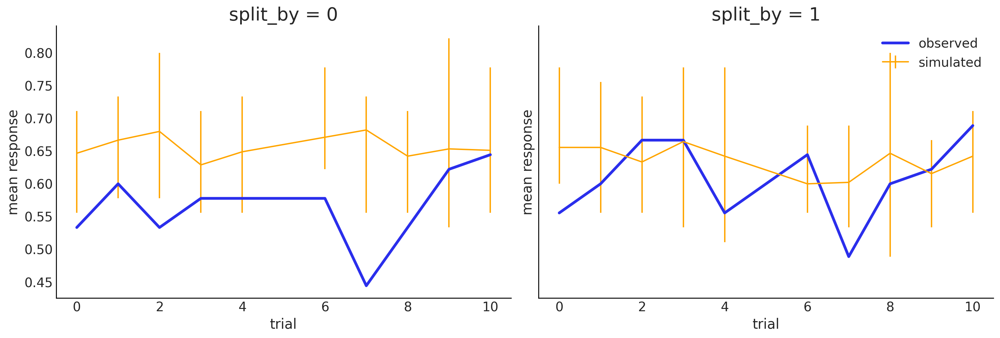

In [107]:
# plotting evolution of choice proportion for best option across learning for observed and simulated data.
fig, axs = plt.subplots(figsize=(15, 5), nrows=1, ncols=2, sharex=True, sharey=True)
for i in range(0, 2):
    ax = axs[i]
    d = ppc_sim[(ppc_sim.split_by == i) & (ppc_sim.type == "simulated")]
    ax.errorbar(
        d.bin_trial,
        d.response,
        yerr=[d.low_err, d.up_err],
        label="simulated",
        color="orange",
    )
    d = ppc_sim[(ppc_sim.split_by == i) & (ppc_sim.type == "observed")]
    ax.plot(d.bin_trial, d.response, linewidth=3, label="observed")
    ax.set_title("split_by = %i" % i, fontsize=20)
    ax.set_ylabel("mean response")
    ax.set_xlabel("trial")
plt.legend()
fig.savefig("PPCchoice.pdf")

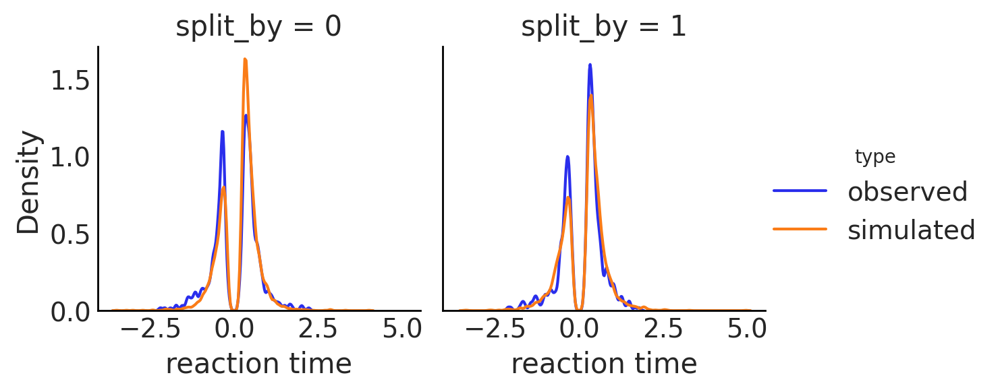

In [108]:
# set reaction time to be negative for lower bound responses (response=0)
plot_ppc_data['reaction time'] = np.where(
    plot_ppc_data['response'] == 1, plot_ppc_data.rt, 0-plot_ppc_data.rt)
# plotting evolution of choice proportion for best option across learning for observed and simulated data. We use bins of trials because plotting individual trials would be very noisy.
g = sns.FacetGrid(plot_ppc_data, col='split_by', hue='type')
g.map(sns.kdeplot, 'reaction time', bw=0.075).set_ylabels("Density")
g.add_legend()
g.savefig('PPCrt_dist.pdf')

## Add `subj_code`

Save posterior means of the HDDMrl parameters for all participants, together with `subj_code` in a csv file in the directory `data/processed/prl/subj_hddm_params`.

In [9]:
%run py_scripts/subj_code_hddm_params.py